# Challenge

We are the team composed by:

- Carlos Aznar (capitán)
- Jason Carneiro
- Elías Carrilo
- Alejandro Rodríguez
- Adrián Blázquez

In this project we discuss how to make three models accurate and precise (one geometric, a decision tree and a GaussianNB). To do so:

It is appreciated that 3.2 and 4 and included in another notebook.

# 1. The knowledge domain is analyzed
# 2. Exploratory analysis
# 3. Machine learning model
## 3.1. First approach
## 3.2. Second approach
# 4. Result of the competition


------------------
--------------

# 1. The knowledge domain is analyzed

Analice el dataset proporcionado, entendiendo las variables del mismo, y su significado. Discuta en grupo sus intuiciones sobre qué variables pueden ser buenos predictores del riesgo asociado. Resuman sus conclusiones en el cuaderno (notebook) de Jupyter.

Para ello, a continuación, se lee el dataset, y se presenta en una tabla la descripción de las variables que se propone en Kaagle. Se plantea que las varaibles más relacionadas con el poder adquisitivo del futuro deudor serán aquellas a priori más relacionadas, como el número de empleados. En cambio, sobre variables como la fecha o el nombre, no se espera gran correlación, a no ser que en las fechas se aprecien un mal momento para el banco que le obligue a conceder pocos créditos. En cuanto al nombre, directamente el nombre no parece que se pueda encontrar correlación, sin embargo, si se establece una realción entre el nombre y el sector de la empresa, entonces, sí, o al menos en la videa real, sí se podría.

Para ello se lee el dataset de train para cargar el data frame.

## Load data

In [2]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from pandas import Series, DataFrame

data = pd.read_csv('data/train.csv', sep=",", encoding = "ISO-8859-1")
df = data.copy()

data_test_nolabel = pd.read_csv('data/test_nolabel.csv', sep=",", encoding = "ISO-8859-1")
df_test_nolabel = data_test_nolabel.copy()

In [3]:
data_test_nolabel = pd.read_csv('data/test_nolabel.csv', sep=",", encoding = "ISO-8859-1")
df_test_nolabel = data_test_nolabel.copy()

## Examining the DataFrame

In [4]:
# we can get the number of samples and features
df.shape

(49320, 22)

In [5]:
#Nótese que no incluye el campo 'Accept'
df_test_nolabel.shape

(7994, 21)

In [6]:
df.head()

,id,LoanNr_ChkDgt,Name,City,State,Bank,BankState,ApprovalDate,ApprovalFY,NoEmp,...,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,Accept
0,d30838cf806,6340864010,QUALITY DOCUMENT SOLUTIONS INC,ODESSA,TX,WELLS FARGO BANK NATL ASSOC,SD,22-May-03,2003,10,...,10,1,1,0,N,NaN,30-Jun-03,"$150,000.00",$0.00,1
1,14560b856a6,1670916004,ATLANTIC INDUSTRIAL WOOD PRODU,KELLER,TX,WELLS FARGO BANK NATL ASSOC,CA,7-Apr-06,2006,1,...,1,1,1,Y,N,NaN,31-Jul-06,"$250,000.00",$0.00,1
2,051e5c3899f,7568313003,C J TREEHOUSE INC.,EL PASO,TX,BANK OF AMERICA NATL ASSOC,TX,12-Sep-94,1994,5,...,0,1,0,N,Y,NaN,31-Oct-94,"$53,000.00",$0.00,1
3,eb223b05ea8,4585814005,WINGSTOP,SAN ANTONIO,TX,COMPASS BANK,AL,18-Jun-01,2001,1,...,1,89769,1,0,N,NaN,31-Aug-01,"$170,000.00",$0.00,1
4,c80c89ac964,2003866003,H & H MACHINE & SUPPLY INC,ODESSA,TX,SOUTHWEST BANK,TX,12-May-06,2006,5,...,5,1,1,0,N,NaN,31-May-06,"$121,000.00",$0.00,1


In [7]:
df_test_nolabel.head()

,id,LoanNr_ChkDgt,Name,City,State,Bank,BankState,ApprovalDate,ApprovalFY,NoEmp,...,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross
0,6b460a6cfab,4223294007,NORTH MAIN CAR WASH,BAYTOWN,TX,COMERICA BANK,TX,18-Jan-01,2001,3,...,0,3,1,1,0,N,NaN,31-Jan-01,"$467,500.00",$0.00
1,2ace454000f,6838264004,TEST ENTERPRISES,HOUSTON,TX,BBCN BANK,CA,24-Oct-03,2004,1,...,1,1,1,0,0,N,20-Sep-04,31-Oct-03,"$5,000.00",$0.00
2,cfdced145b2,7473194008,AUSTIN HOME MEDICAL EQUIPMENT,AUSTIN,TX,BANK OF AMERICA NATL ASSOC,NC,26-May-04,2004,3,...,0,3,1,1,Y,N,NaN,30-Jun-04,"$46,500.00",$0.00
3,00a997fa48d,4874985002,Phong H. Nguyen,TOMBALL,TX,JPMORGAN CHASE BANK NATL ASSOC,IL,20-Sep-11,2011,0,...,0,0,0,1,Y,N,14-Aug-14,20-Sep-11,"$69,479.00",$0.00
4,4a4cbc40146,2103645008,Perez Trucking,HUTCHINS,TX,BANK OF AMERICA NATL ASSOC,NC,2-Nov-06,2007,1,...,0,1,0,1,Y,N,10-Jan-12,30-Nov-06,"$37,500.00",$0.00


In [8]:
# Information about columns and their types
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49320 entries, 0 to 49319
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 49320 non-null  object 
 1   LoanNr_ChkDgt      49320 non-null  int64  
 2   Name               49319 non-null  object 
 3   City               49320 non-null  object 
 4   State              49320 non-null  object 
 5   Bank               49120 non-null  object 
 6   BankState          49120 non-null  object 
 7   ApprovalDate       49320 non-null  object 
 8   ApprovalFY         49320 non-null  object 
 9   NoEmp              49320 non-null  int64  
 10  NewExist           49313 non-null  float64
 11  CreateJob          49320 non-null  int64  
 12  RetainedJob        49320 non-null  int64  
 13  FranchiseCode      49320 non-null  int64  
 14  UrbanRural         49320 non-null  int64  
 15  RevLineCr          49031 non-null  object 
 16  LowDoc             491

In [9]:
df_test_nolabel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7994 entries, 0 to 7993
Data columns (total 21 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 7994 non-null   object 
 1   LoanNr_ChkDgt      7994 non-null   int64  
 2   Name               7994 non-null   object 
 3   City               7994 non-null   object 
 4   State              7994 non-null   object 
 5   Bank               7974 non-null   object 
 6   BankState          7974 non-null   object 
 7   ApprovalDate       7994 non-null   object 
 8   ApprovalFY         7994 non-null   object 
 9   NoEmp              7994 non-null   int64  
 10  NewExist           7994 non-null   float64
 11  CreateJob          7994 non-null   int64  
 12  RetainedJob        7994 non-null   int64  
 13  FranchiseCode      7994 non-null   int64  
 14  UrbanRural         7994 non-null   int64  
 15  RevLineCr          7964 non-null   object 
 16  LowDoc             7954 

In [10]:
# Basic statistics of the dataset in all the numeric columns
df.describe()

,LoanNr_ChkDgt,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,Accept
count,4.932000e+04,49320.000000,49313.000000,49320.000000,49320.000000,49320.000000,49320.000000,49320.000000
mean,4.941161e+09,10.794505,1.317361,9.871006,11.930211,3933.928062,0.658942,0.810929
std,2.530125e+09,44.645641,0.467497,262.815556,266.334776,15141.332203,0.595339,0.391569
min,1.000254e+09,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.731376e+09,2.000000,1.000000,0.000000,0.000000,1.000000,0.000000,1.000000
50%,4.598009e+09,4.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000
75%,7.141562e+09,10.000000,2.000000,1.000000,3.000000,1.000000,1.000000,1.000000
max,9.995563e+09,4000.000000,2.000000,8800.000000,9500.000000,92000.000000,2.000000,1.000000


In [11]:
df_test_nolabel.describe()

,LoanNr_ChkDgt,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural
count,7.994000e+03,7994.000000,7994.000000,7994.000000,7994.000000,7994.000000,7994.000000
mean,4.683606e+09,9.502752,1.342757,21.968852,23.745934,3993.877533,0.737928
std,2.541415e+09,59.635769,0.475188,417.082161,417.087081,15240.420287,0.572959
min,1.003326e+09,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.509531e+09,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000
50%,3.985554e+09,4.000000,1.000000,0.000000,1.000000,1.000000,1.000000
75%,6.883318e+09,9.000000,2.000000,2.000000,4.000000,1.000000,1.000000
max,9.989773e+09,5084.000000,2.000000,8800.000000,8800.000000,91280.000000,2.000000


| Column |  Non-Null Count | Dtype | Description | 
| --- | --- | --- |--- |   
| 0   id |                49320 non-null | object | Identifier of the data instance |
| 1   LoanNr_ChkDgt  |    49320 non-null | int64  | Identifier of the loan petition|
| 2   Name      |         49319 non-null | object | Borrower name |
| 3   City       |        49320 non-null | object | Borrower city |
| 4   State       |       49320 non-null | object | Borrower state |
| 5   Bank         |      49120 non-null | object | Bank name |
| 6   BankState     |     49120 non-null | object | Bank state |
| 7   ApprovalDate  |     49320 non-null | object | Date SBA commitment issued |
| 8   ApprovalFY  |        49320 non-null | object | Fiscal year of commitment |
| 9   NoEmp        |      49320 non-null  | int64  | Number of business employees |
| 10  NewExist     |      49313 non-null | float64| Existing = 1/New = 2 Business |
| 11  CreateJob    |      49320 non-null | int64  | Number of jobs created |
| 12  RetainedJob   |     49320 non-null | int64  | Number of jobs retained |
| 13  FranchiseCode  |    49320 non-null | int64  | Franchise code |
| 14  UrbanRural     |    49320 non-null | int64  | Urban = 1/Rural = 2 |
| 15  RevLineCr      |    49031 non-null | object | Revolving line of credit |
| 16  LowDoc         |    49160 non-null | object | Low Documentation Loan |
| 17  ChgOffDate      |   9571 non-null  | object | The date when a loan is declared to be in default. ChargeOff  |
| 18  DisbursementDate  |  49194 non-null | object | Disbursement date |
| 19  DisbursementGross | 49320 non-null | object | Amount disbursed |
| 20  BalanceGross     |  49320 non-null | object | Gross amount outstanding |
|  21  Accept          |   49320 non-null | int64 | Accepted = 1/Not Accepted = 0 |

# 2. Exploratory analysis

Analice el dataset para confirmar (o desestimar) sus hipótesis y discuta sus descubrimientos en el cuaderno.

Con este fin primero se realiza un análisis inicial, se encuntra la correlación y que muchas varaibles están correladas como objects, y a contianución se codifican estás como intergers para poder hallar correlaciones.

## a. Type of values
## b. Ratio of accept records
## c. Distribution of variables
## d. Data Munging

-------------------

## a. Type of values

### a. Nan Values

In [12]:
df.dtypes

id                    object
LoanNr_ChkDgt          int64
Name                  object
City                  object
State                 object
Bank                  object
BankState             object
ApprovalDate          object
ApprovalFY            object
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr             object
LowDoc                object
ChgOffDate            object
DisbursementDate      object
DisbursementGross     object
BalanceGross          object
Accept                 int64
dtype: object

Visualización de los tipos de datos en un gráfico de tipo pie.

<AxesSubplot:ylabel='None'>

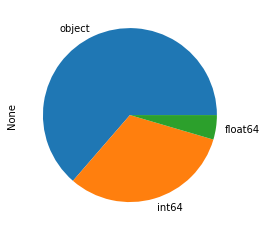

In [13]:
df.dtypes.value_counts().plot.pie()

Podemos observar que hay una gran cantidad de datos cuyo tipo es object y es más conveniente tener datos numéricos.

<AxesSubplot:>

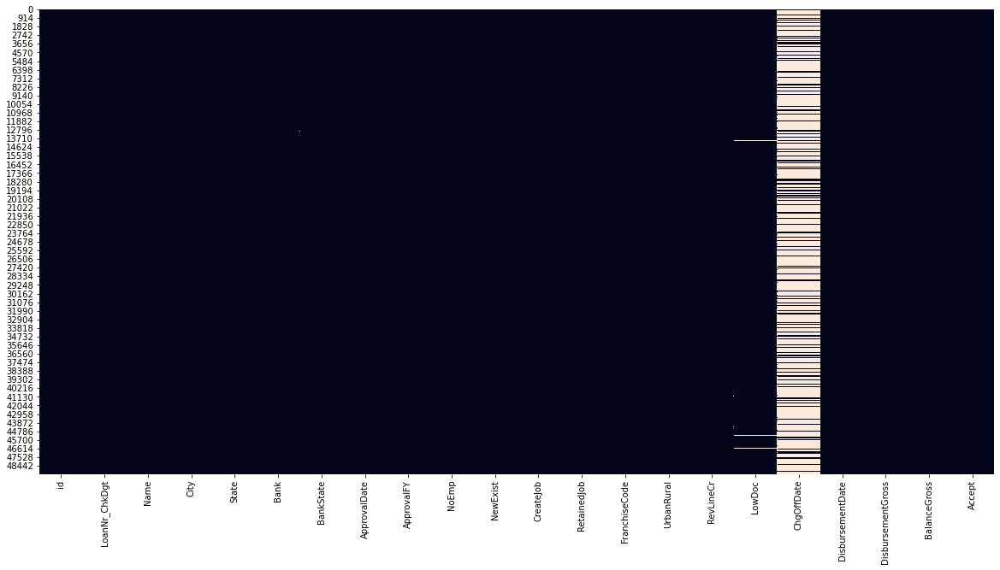

In [14]:
plt.figure(figsize=(20,10))
sns.heatmap(df.isna(), cbar=False)

In [15]:
(df.isna().sum()/df.shape[0]).sort_values(ascending=True)

id                   0.000000
DisbursementGross    0.000000
UrbanRural           0.000000
FranchiseCode        0.000000
RetainedJob          0.000000
CreateJob            0.000000
BalanceGross         0.000000
NoEmp                0.000000
Accept               0.000000
ApprovalDate         0.000000
State                0.000000
City                 0.000000
LoanNr_ChkDgt        0.000000
ApprovalFY           0.000000
Name                 0.000020
NewExist             0.000142
DisbursementDate     0.002555
LowDoc               0.003244
BankState            0.004055
Bank                 0.004055
RevLineCr            0.005860
ChgOffDate           0.805941
dtype: float64

In [16]:
(df_test_nolabel.isna().sum()/df_test_nolabel.shape[0]).sort_values(ascending=True)

id                   0.000000
UrbanRural           0.000000
FranchiseCode        0.000000
RetainedJob          0.000000
CreateJob            0.000000
DisbursementGross    0.000000
NoEmp                0.000000
ApprovalFY           0.000000
NewExist             0.000000
State                0.000000
City                 0.000000
Name                 0.000000
LoanNr_ChkDgt        0.000000
ApprovalDate         0.000000
BalanceGross         0.000000
DisbursementDate     0.002127
BankState            0.002502
Bank                 0.002502
RevLineCr            0.003753
LowDoc               0.005004
ChgOffDate           0.497373
dtype: float64

Se puede observar que hay bastantes datos sin valor (NaN). A continuación:<br>
- Eliminamos la columna "ChgOffDate" ya que el 80% es NaN, pero luego nos damos cuenta que está muy relacionada con el accept.
- Eliminamos la columna "State" porque su valor solo es TX, por lo que no será relevante.
- Eliminamos la columna "BalanceGross" porque solo contiene el valor '$0.00'.
- Podemos eliminar la columna 'id' porque que es inútil para el aprendizaje de nuestro modelo debido a que cada valor es único.

In [17]:
# drop ChgOffDate column
#df.drop(['ChgOffDate'], axis=1, inplace=True)
df.drop(['State'], axis=1, inplace=True)
df.drop(['BalanceGross'], axis=1, inplace=True)
df.drop(['id'], axis=1, inplace=True)

In [18]:
# drop ChgOffDate column
#df_test_nolabel.drop(['ChgOffDate'], axis=1, inplace=True)
df_test_nolabel.drop(['State'], axis=1, inplace=True)
df_test_nolabel.drop(['BalanceGross'], axis=1, inplace=True)
#df_test_nolabel.drop(['id'], axis=1, inplace=True)

In [19]:
df.shape

(49320, 19)

In [20]:
df_test_nolabel.shape

(7994, 19)

Comprobamos de nuevo el heatmap para ver si siguen quedando muchos espacios blancos.

<AxesSubplot:>

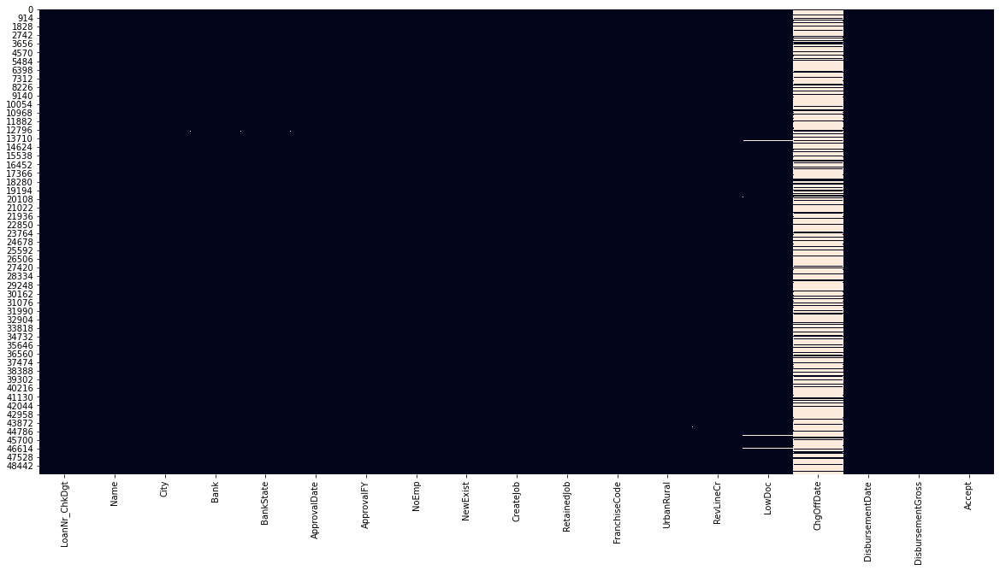

In [21]:
plt.figure(figsize=(20,10))
sns.heatmap(df.isna(), cbar=False)

<AxesSubplot:>

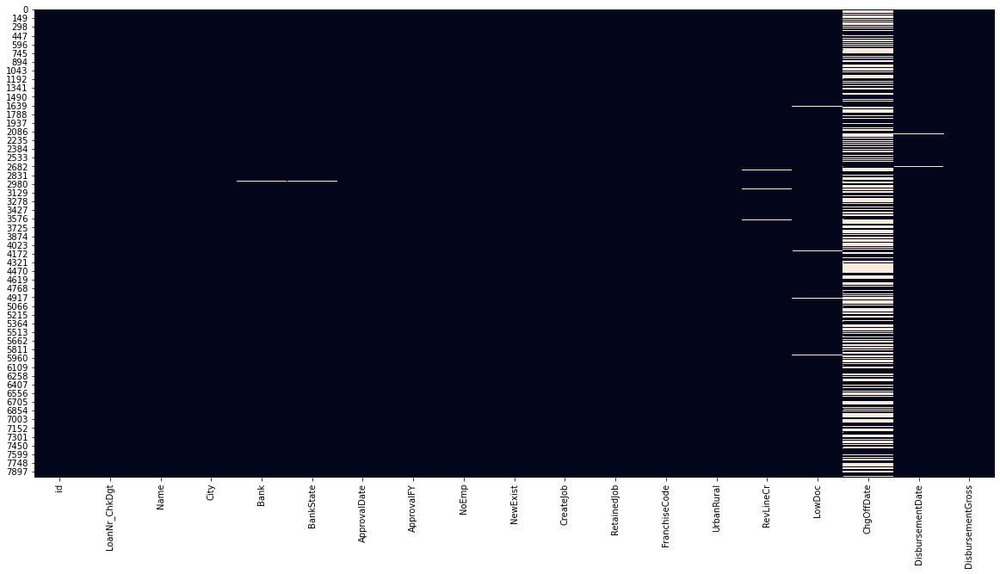

In [22]:
plt.figure(figsize=(20,10))
sns.heatmap(df_test_nolabel.isna(), cbar=False)

## b. Ratio of accept records

In [23]:
df['Accept'].value_counts(normalize=True)

1    0.810929
0    0.189071
Name: Accept, dtype: float64

El ratio de aceptación es de un 81%.

## c. Distribution of variables

C:\Users\ablaz\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


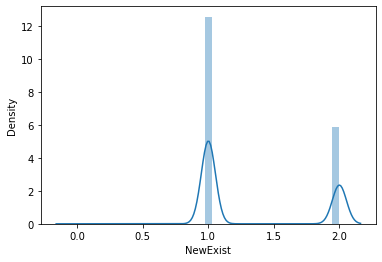

In [24]:
for col in df.select_dtypes('float'):
    plt.figure()
    sns.distplot(df[col])

C:\Users\ablaz\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\ablaz\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\ablaz\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-lev

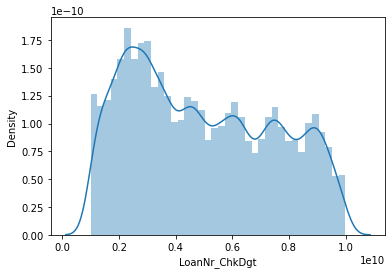

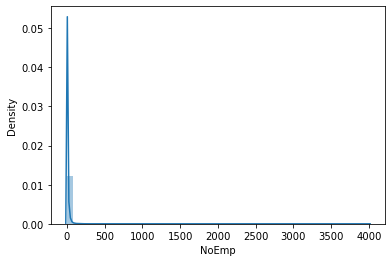

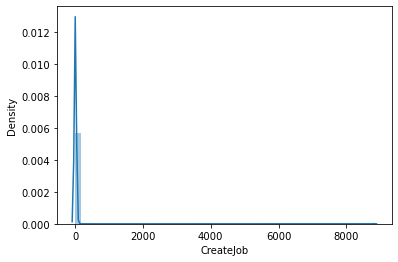

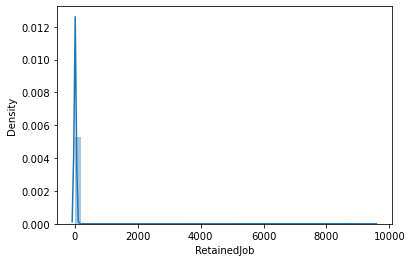

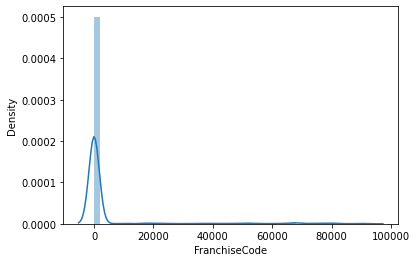

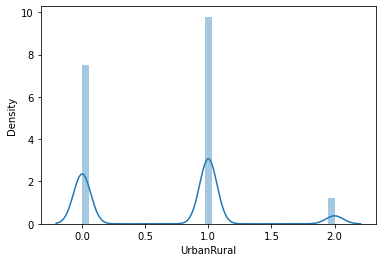

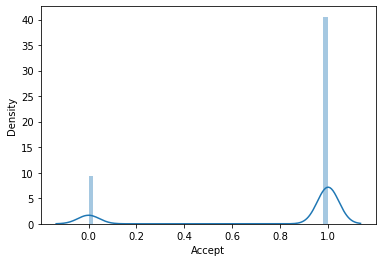

In [25]:
for col in df.select_dtypes('int64'):
    plt.figure()
    sns.distplot(df[col])

In [26]:
df_categorical = df.select_dtypes('object')
categorical_columns = df_categorical.columns
df_categorical.columns

Index(['Name', 'City', 'Bank', 'BankState', 'ApprovalDate', 'ApprovalFY',
       'RevLineCr', 'LowDoc', 'ChgOffDate', 'DisbursementDate',
       'DisbursementGross'],
      dtype='object')

In [27]:
df.columns

Index(['LoanNr_ChkDgt', 'Name', 'City', 'Bank', 'BankState', 'ApprovalDate',
       'ApprovalFY', 'NoEmp', 'NewExist', 'CreateJob', 'RetainedJob',
       'FranchiseCode', 'UrbanRural', 'RevLineCr', 'LowDoc', 'ChgOffDate',
       'DisbursementDate', 'DisbursementGross', 'Accept'],
      dtype='object')

Analizamos la correlación de los datos.

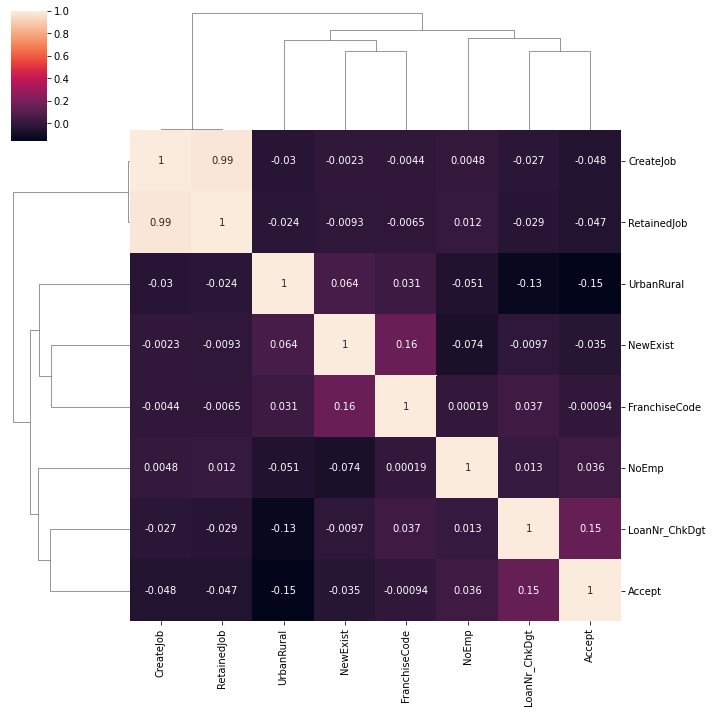

In [28]:
data.corr()
corrMatrix = data.corr()
sns.clustermap(corrMatrix, annot=True)
plt.show()

Con pairplot trazamos relaciones por pares entre los datos. 

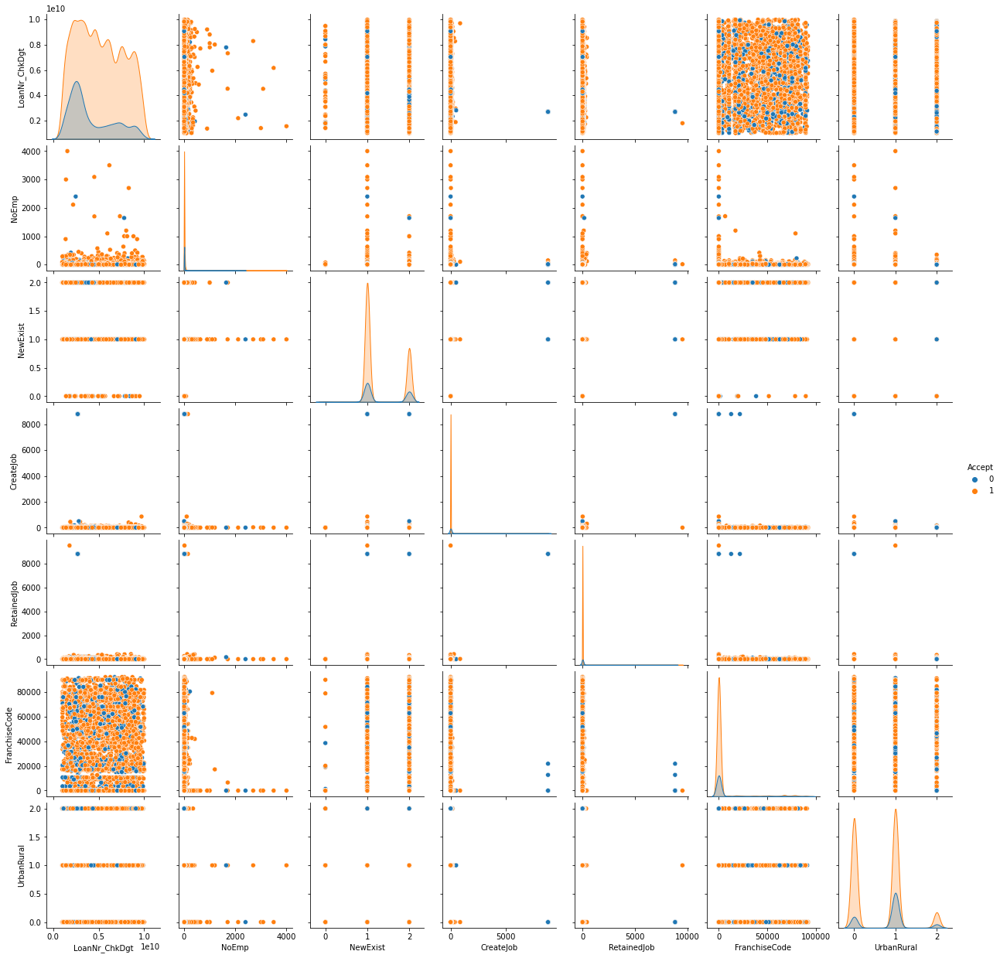

In [29]:
sns.pairplot(df,hue='Accept')

In [30]:
pd.crosstab(df['Bank'], df['Accept'])

Accept,0,1
Bank,,
"1ST BANK, NATIONAL ASSOCIATION",1,0
1ST CHOICE BANK,0,3
1ST COMMERCIAL CAPITAL,4,2
1ST COMMUNITY FCU,0,3
1ST LIB NATL BK,0,1
...,...,...
YELLOWSTONE BANK,1,0
YOAKUM NATIONAL BANK,0,3
ZAPATA NATIONAL BANK,3,1


In [31]:
df.describe()

,LoanNr_ChkDgt,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,Accept
count,4.932000e+04,49320.000000,49313.000000,49320.000000,49320.000000,49320.000000,49320.000000,49320.000000
mean,4.941161e+09,10.794505,1.317361,9.871006,11.930211,3933.928062,0.658942,0.810929
std,2.530125e+09,44.645641,0.467497,262.815556,266.334776,15141.332203,0.595339,0.391569
min,1.000254e+09,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.731376e+09,2.000000,1.000000,0.000000,0.000000,1.000000,0.000000,1.000000
50%,4.598009e+09,4.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000
75%,7.141562e+09,10.000000,2.000000,1.000000,3.000000,1.000000,1.000000,1.000000
max,9.995563e+09,4000.000000,2.000000,8800.000000,9500.000000,92000.000000,2.000000,1.000000


In [32]:
pd.crosstab(df['Name'], df['Accept'])

Accept,0,1
Name,,
"""ALEXANDRA G"" SHRIMP TRAWLER",1,0
"""CINDY NAN"" F/V",0,1
"""CLIMB"" ENTERPRISES, INC.",0,1
"""DOC'S FOOD STORE""",0,1
"""HOOT"" GIBSON SALES CO.",1,0
...,...,...
olga serna,1,0
parallax Services Inc.,0,1
the Emerald I Group L L C,1,0


In [33]:
df_accepted = df[df['Accept'] == 1]
df_refused = df[df['Accept'] == 0]

C:\Users\ablaz\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\ablaz\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\ablaz\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-lev

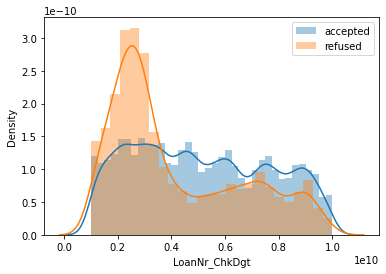

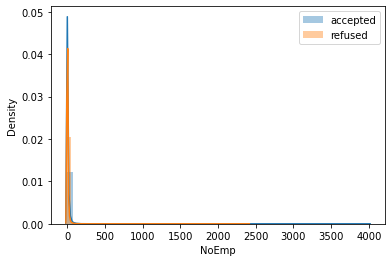

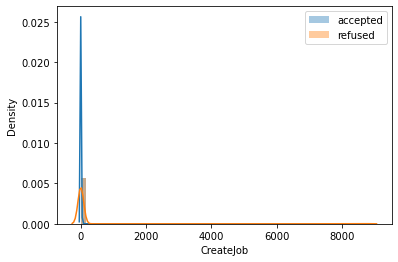

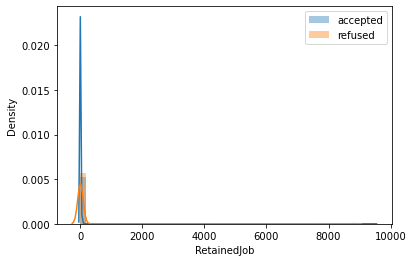

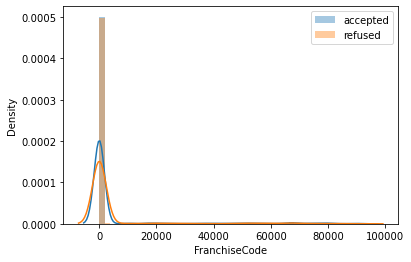

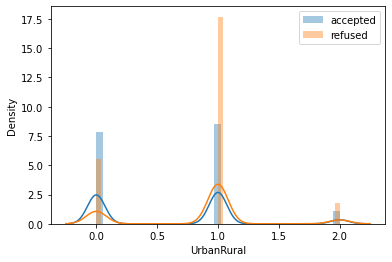

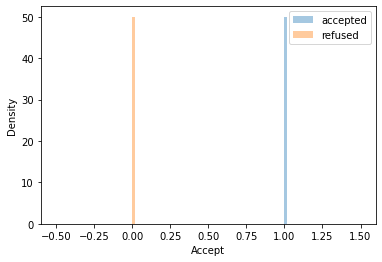

In [34]:
for col in df.select_dtypes('int64'):
    plt.figure()
    sns.distplot(df_accepted[col], label='accepted')
    sns.distplot(df_refused[col], label='refused')
    plt.legend()

Podemos ver que cuando UrbanRural es igual a 1 hay muchos rechazados.

C:\Users\ablaz\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\ablaz\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


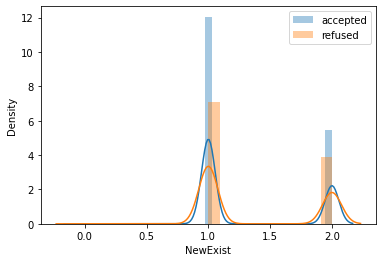

In [35]:
for col in df.select_dtypes('float'):
    plt.figure()
    sns.distplot(df_accepted[col], label='accepted')
    sns.distplot(df_refused[col], label='refused')
    plt.legend()

In [36]:
df.var()

LoanNr_ChkDgt    6.401534e+18
NoEmp            1.993233e+03
NewExist         2.185534e-01
CreateJob        6.907202e+04
RetainedJob      7.093421e+04
FranchiseCode    2.292599e+08
UrbanRural       3.544285e-01
Accept           1.533265e-01
dtype: float64

Como faltan muy pocos datos, decidimos eliminar las filas con valores perdidos para no cambiar la realidad.

 ## d) Data Munging

### DisbursementGross
Let's change the format of the "DisbursementGross" column from this 30-Jun-03 to 3 columns with the day, the moth and the year associated.

In [37]:
df['DisbursementDate']

0        30-Jun-03
1        31-Jul-06
2        31-Oct-94
3        31-Aug-01
4        31-May-06
           ...    
49315    31-Mar-02
49316    30-Sep-05
49317    31-Jan-94
49318    31-Oct-07
49319    31-Dec-96
Name: DisbursementDate, Length: 49320, dtype: object

In [38]:
#Change the format into datetime
df['DisbursementDate'] = pd.to_datetime(data['DisbursementDate'])

In [39]:
#Change the format into datetime
df_test_nolabel['DisbursementDate'] = pd.to_datetime(data['DisbursementDate'])

We create new columns ''DisbursementDay', 'DisbursementMonth', 'DisbursementYear'

In [40]:
df['DisbursementDay'] = df['DisbursementDate'].apply(lambda x: x.day)
df['DisbursementDay']

0        30.0
1        31.0
2        31.0
3        31.0
4        31.0
         ... 
49315    31.0
49316    30.0
49317    31.0
49318    31.0
49319    31.0
Name: DisbursementDay, Length: 49320, dtype: float64

In [41]:
df_test_nolabel['DisbursementDay'] = df_test_nolabel['DisbursementDate'].apply(lambda x: x.day)
df_test_nolabel['DisbursementDay']

0       30.0
1       31.0
2       31.0
3       31.0
4       31.0
        ... 
7989    31.0
7990    30.0
7991    31.0
7992    31.0
7993    30.0
Name: DisbursementDay, Length: 7994, dtype: float64

In [42]:
df['DisbursementMonth'] = df['DisbursementDate'].apply(lambda x: x.month)
df['DisbursementMonth'] 

0         6.0
1         7.0
2        10.0
3         8.0
4         5.0
         ... 
49315     3.0
49316     9.0
49317     1.0
49318    10.0
49319    12.0
Name: DisbursementMonth, Length: 49320, dtype: float64

In [43]:
df_test_nolabel['DisbursementMonth'] = df_test_nolabel['DisbursementDate'].apply(lambda x: x.month)
df_test_nolabel['DisbursementMonth'] 

0        6.0
1        7.0
2       10.0
3        8.0
4        5.0
        ... 
7989    12.0
7990    11.0
7991    10.0
7992     1.0
7993     4.0
Name: DisbursementMonth, Length: 7994, dtype: float64

In [44]:
df['DisbursementYear'] = df['DisbursementDate'].apply(lambda x: x.year)
df['DisbursementYear'] 

0        2003.0
1        2006.0
2        1994.0
3        2001.0
4        2006.0
          ...  
49315    2002.0
49316    2005.0
49317    1994.0
49318    2007.0
49319    1996.0
Name: DisbursementYear, Length: 49320, dtype: float64

In [45]:
df_test_nolabel['DisbursementYear'] = df_test_nolabel['DisbursementDate'].apply(lambda x: x.year)
df_test_nolabel['DisbursementYear'] 

0       2003.0
1       2006.0
2       1994.0
3       2001.0
4       2006.0
         ...  
7989    2000.0
7990    2000.0
7991    1997.0
7992    1995.0
7993    2004.0
Name: DisbursementYear, Length: 7994, dtype: float64

In [46]:
# We can now delete the 'DisbursementDate' column.
df.drop(['DisbursementDate'], axis=1, inplace=True)

In [47]:
# We can now delete the 'DisbursementDate' column.
df_test_nolabel.drop(['DisbursementDate'], axis=1, inplace=True)

### ApprovalDate
Let's change the format of the "ApprovalDate" column from this 30-Jun-03 to 3 columns with the day, the moth and the year associated.

In [48]:
df['ApprovalDate']

0        22-May-03
1         7-Apr-06
2        12-Sep-94
3        18-Jun-01
4        12-May-06
           ...    
49315    23-Oct-01
49316     4-Aug-05
49317     3-Aug-93
49318    21-Sep-07
49319     9-Jul-96
Name: ApprovalDate, Length: 49320, dtype: object

In [49]:
df_test_nolabel['ApprovalDate']

0       18-Jan-01
1       24-Oct-03
2       26-May-04
3       20-Sep-11
4        2-Nov-06
          ...    
7989    18-Jan-01
7990     4-Jan-01
7991     8-Apr-05
7992    10-Feb-06
7993     6-Aug-04
Name: ApprovalDate, Length: 7994, dtype: object

In [50]:
#Change the format into datetime
df['ApprovalDate'] = pd.to_datetime(data['ApprovalDate'])

In [51]:
#Change the format into datetime
df_test_nolabel['ApprovalDate'] = pd.to_datetime(data['ApprovalDate'])

In [52]:
df['ApprovalDay'] = df['ApprovalDate'].apply(lambda x: x.day)
df['ApprovalMonth'] = df['ApprovalDate'].apply(lambda x: x.month)
df['ApprovalYear'] = df['ApprovalDate'].apply(lambda x: x.year)

In [53]:
df_test_nolabel['ApprovalDay'] = df_test_nolabel['ApprovalDate'].apply(lambda x: x.day)
df_test_nolabel['ApprovalMonth'] = df_test_nolabel['ApprovalDate'].apply(lambda x: x.month)
df_test_nolabel['ApprovalYear'] = df_test_nolabel['ApprovalDate'].apply(lambda x: x.year)

In [54]:
# We can now delete the 'ApprovalDate' column.
df.drop(['ApprovalDate'], axis=1, inplace=True)

In [55]:
# We can now delete the 'ApprovalDate' column.
df_test_nolabel.drop(['ApprovalDate'], axis=1, inplace=True)

### DisbursementGross
Let's change the format of the "DisbursementGross" column from this $ 150,000.00 to 150000.

In [56]:
df['DisbursementGross']

0        $150,000.00 
1        $250,000.00 
2         $53,000.00 
3        $170,000.00 
4        $121,000.00 
             ...     
49315     $63,000.00 
49316     $25,000.00 
49317    $200,000.00 
49318     $35,000.00 
49319     $90,000.00 
Name: DisbursementGross, Length: 49320, dtype: object

In [57]:
df_test_nolabel['DisbursementGross']

0         $467,500.00 
1           $5,000.00 
2          $46,500.00 
3          $69,479.00 
4          $37,500.00 
             ...      
7989    $2,000,000.00 
7990       $71,500.00 
7991       $19,000.00 
7992      $500,000.00 
7993      $150,000.00 
Name: DisbursementGross, Length: 7994, dtype: object

In [58]:
def clean_currency(x):
   
    if isinstance(x, str):
        return(x.replace('$', '').replace(',', ''))
    return(x)

In [59]:
df['DisbursementGross'] = df['DisbursementGross'].apply(clean_currency).astype('float')

In [60]:
df_test_nolabel['DisbursementGross'] = df_test_nolabel['DisbursementGross'].apply(clean_currency).astype('float')

In [61]:
df['DisbursementGross']

0        150000.0
1        250000.0
2         53000.0
3        170000.0
4        121000.0
           ...   
49315     63000.0
49316     25000.0
49317    200000.0
49318     35000.0
49319     90000.0
Name: DisbursementGross, Length: 49320, dtype: float64

In [62]:
df_test_nolabel['DisbursementGross']

0        467500.0
1          5000.0
2         46500.0
3         69479.0
4         37500.0
          ...    
7989    2000000.0
7990      71500.0
7991      19000.0
7992     500000.0
7993     150000.0
Name: DisbursementGross, Length: 7994, dtype: float64

### For the other columns of type 'Object' we will create a function which associates to the Strings a value.

### Name

In [63]:
name = []

lista_1 = dict()
for i in range (0, 49320): 
    name.append(df['Name'][i])
    
for j in range (0, 49320):
        
    if df['Name'][j] not in lista_1: 
        c = name[j]
        df['Name'][j] = j
        lista_1[c] = j
        print(c)
        print(df['Name'][j])
        print(lista_1)
        
    else :
        df['Name'][j] = lista_1[df['Name'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


QUALITY DOCUMENT SOLUTIONS INC
0
{'QUALITY DOCUMENT SOLUTIONS INC': 0}
ATLANTIC INDUSTRIAL WOOD PRODU
1
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1}
C J TREEHOUSE INC.
2
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2}
WINGSTOP
3
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3}
H & H MACHINE & SUPPLY INC
4
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4}
KWIK KAR WASH OF WATAGUA
5
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4, 'KWIK KAR WASH OF WATAGUA': 5}
THE SOCCER POST
6
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4, 'KWIK KAR WASH OF WATAGUA

PANAS CAFE
111
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4, 'KWIK KAR WASH OF WATAGUA': 5, 'THE SOCCER POST': 6, 'DFW-OUTDOOR, LLC': 7, 'O D DISTRIBUTING,INC': 8, 'STEPHANIE MCDONALD ENTERPRISES': 9, 'J & G SALES': 10, 'TEXAS AND THE TERRITORIES, INC': 11, 'SPORTS CLIPS': 12, 'STAGECOACH THEATER': 13, "POP'S GRILL & PIZZA, LLC": 14, 'Dawn and Rae Inc.': 15, 'ALL AMERICAN CONCRETE': 16, 'D K FOOT & CASUAL': 17, 'BLIMPIES': 18, 'CROSSROADS CONVENIENCE STORE': 19, 'ALL UNITY INC': 20, 'INTI TRANSPORTATION LLC': 21, 'RR RAMSOWER INC': 22, 'IMAGE IDEAS, INC.': 23, 'Tectonic Graffiti Design Studi': 24, 'CUSTOM HELIARC': 25, 'LOGAN FARMS HONEY GLAZED HAMS': 26, 'LAUNDRY CITY': 27, 'DESIGN EDGE': 28, 'ARLINGTON STEAKHOUSE': 29, 'DENTAL AND AESTHETIC SPECIALIS': 30, 'TOTAL RECOVERY PHYSICAL MODALI': 31, 'El Paso Pros Sportswear': 32, 'C & L DELI PROVISIONS L P': 33, 'Victor Jones CPA': 34, 'DR

DESIGN INITIATIVE GROUP INC
198
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4, 'KWIK KAR WASH OF WATAGUA': 5, 'THE SOCCER POST': 6, 'DFW-OUTDOOR, LLC': 7, 'O D DISTRIBUTING,INC': 8, 'STEPHANIE MCDONALD ENTERPRISES': 9, 'J & G SALES': 10, 'TEXAS AND THE TERRITORIES, INC': 11, 'SPORTS CLIPS': 12, 'STAGECOACH THEATER': 13, "POP'S GRILL & PIZZA, LLC": 14, 'Dawn and Rae Inc.': 15, 'ALL AMERICAN CONCRETE': 16, 'D K FOOT & CASUAL': 17, 'BLIMPIES': 18, 'CROSSROADS CONVENIENCE STORE': 19, 'ALL UNITY INC': 20, 'INTI TRANSPORTATION LLC': 21, 'RR RAMSOWER INC': 22, 'IMAGE IDEAS, INC.': 23, 'Tectonic Graffiti Design Studi': 24, 'CUSTOM HELIARC': 25, 'LOGAN FARMS HONEY GLAZED HAMS': 26, 'LAUNDRY CITY': 27, 'DESIGN EDGE': 28, 'ARLINGTON STEAKHOUSE': 29, 'DENTAL AND AESTHETIC SPECIALIS': 30, 'TOTAL RECOVERY PHYSICAL MODALI': 31, 'El Paso Pros Sportswear': 32, 'C & L DELI PROVISIONS L P': 33, 'Victor Jo

PRO PLAY ZONE INC
277
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4, 'KWIK KAR WASH OF WATAGUA': 5, 'THE SOCCER POST': 6, 'DFW-OUTDOOR, LLC': 7, 'O D DISTRIBUTING,INC': 8, 'STEPHANIE MCDONALD ENTERPRISES': 9, 'J & G SALES': 10, 'TEXAS AND THE TERRITORIES, INC': 11, 'SPORTS CLIPS': 12, 'STAGECOACH THEATER': 13, "POP'S GRILL & PIZZA, LLC": 14, 'Dawn and Rae Inc.': 15, 'ALL AMERICAN CONCRETE': 16, 'D K FOOT & CASUAL': 17, 'BLIMPIES': 18, 'CROSSROADS CONVENIENCE STORE': 19, 'ALL UNITY INC': 20, 'INTI TRANSPORTATION LLC': 21, 'RR RAMSOWER INC': 22, 'IMAGE IDEAS, INC.': 23, 'Tectonic Graffiti Design Studi': 24, 'CUSTOM HELIARC': 25, 'LOGAN FARMS HONEY GLAZED HAMS': 26, 'LAUNDRY CITY': 27, 'DESIGN EDGE': 28, 'ARLINGTON STEAKHOUSE': 29, 'DENTAL AND AESTHETIC SPECIALIS': 30, 'TOTAL RECOVERY PHYSICAL MODALI': 31, 'El Paso Pros Sportswear': 32, 'C & L DELI PROVISIONS L P': 33, 'Victor Jones CPA': 

ERGOTECH CONTROLS INC A TEXAS
356
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4, 'KWIK KAR WASH OF WATAGUA': 5, 'THE SOCCER POST': 6, 'DFW-OUTDOOR, LLC': 7, 'O D DISTRIBUTING,INC': 8, 'STEPHANIE MCDONALD ENTERPRISES': 9, 'J & G SALES': 10, 'TEXAS AND THE TERRITORIES, INC': 11, 'SPORTS CLIPS': 12, 'STAGECOACH THEATER': 13, "POP'S GRILL & PIZZA, LLC": 14, 'Dawn and Rae Inc.': 15, 'ALL AMERICAN CONCRETE': 16, 'D K FOOT & CASUAL': 17, 'BLIMPIES': 18, 'CROSSROADS CONVENIENCE STORE': 19, 'ALL UNITY INC': 20, 'INTI TRANSPORTATION LLC': 21, 'RR RAMSOWER INC': 22, 'IMAGE IDEAS, INC.': 23, 'Tectonic Graffiti Design Studi': 24, 'CUSTOM HELIARC': 25, 'LOGAN FARMS HONEY GLAZED HAMS': 26, 'LAUNDRY CITY': 27, 'DESIGN EDGE': 28, 'ARLINGTON STEAKHOUSE': 29, 'DENTAL AND AESTHETIC SPECIALIS': 30, 'TOTAL RECOVERY PHYSICAL MODALI': 31, 'El Paso Pros Sportswear': 32, 'C & L DELI PROVISIONS L P': 33, 'Victor 

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




3109
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4, 'KWIK KAR WASH OF WATAGUA': 5, 'THE SOCCER POST': 6, 'DFW-OUTDOOR, LLC': 7, 'O D DISTRIBUTING,INC': 8, 'STEPHANIE MCDONALD ENTERPRISES': 9, 'J & G SALES': 10, 'TEXAS AND THE TERRITORIES, INC': 11, 'SPORTS CLIPS': 12, 'STAGECOACH THEATER': 13, "POP'S GRILL & PIZZA, LLC": 14, 'Dawn and Rae Inc.': 15, 'ALL AMERICAN CONCRETE': 16, 'D K FOOT & CASUAL': 17, 'BLIMPIES': 18, 'CROSSROADS CONVENIENCE STORE': 19, 'ALL UNITY INC': 20, 'INTI TRANSPORTATION LLC': 21, 'RR RAMSOWER INC': 22, 'IMAGE IDEAS, INC.': 23, 'Tectonic Graffiti Design Studi': 24, 'CUSTOM HELIARC': 25, 'LOGAN FARMS HONEY GLAZED HAMS': 26, 'LAUNDRY CITY': 27, 'DESIGN EDGE': 28, 'ARLINGTON STEAKHOUSE': 29, 'DENTAL AND AESTHETIC SPECIALIS': 30, 'TOTAL RECOVERY PHYSICAL MODALI': 31, 'El Paso Pros Sportswear': 32, 'C & L DELI PROVISIONS L P': 33, 'Victor Jones CPA': 34, 'DR. EMMA GA

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [64]:
name = []

lista_1 = dict()
for i in range (0, 7994): 
    name.append(df_test_nolabel['Name'][i])
    
for j in range (0, 7994):
        
    if df_test_nolabel['Name'][j] not in lista_1: 
        c = name[j]
        df_test_nolabel['Name'][j] = j
        lista_1[c] = j
        print(c)
        print(df_test_nolabel['Name'][j])
        print(lista_1)
        
    else :
        df_test_nolabel['Name'][j] = lista_1[df_test_nolabel['Name'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


NORTH MAIN CAR WASH
0
{'NORTH MAIN CAR WASH': 0}
TEST ENTERPRISES
1
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1}
AUSTIN HOME MEDICAL EQUIPMENT
2
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2}
Phong H. Nguyen
3
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3}
Perez Trucking
4
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3, 'Perez Trucking': 4}
Gamba Health Care
5
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3, 'Perez Trucking': 4, 'Gamba Health Care': 5}
MANHATTAN SANDWICH SHOP #2
6
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3, 'Perez Trucking': 4, 'Gamba Health Care': 5, 'MANHATTAN SANDWICH SHOP #2': 6}
WEST COUNTRY SERVICES LTD
7
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIP

THE HAIR SCENE
218
{'NORTH MAIN CAR WASH': 0, 'TEST ENTERPRISES': 1, 'AUSTIN HOME MEDICAL EQUIPMENT': 2, 'Phong H. Nguyen': 3, 'Perez Trucking': 4, 'Gamba Health Care': 5, 'MANHATTAN SANDWICH SHOP #2': 6, 'WEST COUNTRY SERVICES LTD': 7, 'Robert H. Pickering dba Graffi': 8, 'Hans Auto Connection Inc': 9, 'USA CLEANERS': 10, 'Distinctive Investors': 11, 'BEACHES LTD': 12, "COLTER'S BAR B Q": 13, 'EKER INVESTORS INC': 14, 'JENKINS TURKEY FARMS': 15, 'Mermaid Waterscapes LLC': 16, 'ANGELIC CARE HOME HEALTH INC': 17, 'PDQ DRY CLEANER SUPER STORE': 18, 'BEER BARN II': 19, 'SKYTONE PRODUCTIONS': 20, 'Adam Schydlower': 21, 'CMS MEDICAL INC': 22, 'ACR CONSTRUCTION': 23, 'METALGEAR APPAREL': 24, 'YESI S BEAUTY SALON': 25, 'SERVICE INSURANCE GROUP AGENCY': 26, 'SEAWORLD': 27, 'SPECIALIZED FITNESS,INC': 28, 'K.C. IMPORT COMPANY, INC.': 29, 'GOLDEN CHOPSTICKS CHINESE REST': 30, 'HE ZHANG': 31, 'THE FRENCH COTTAGE BAKERY & CA': 32, 'RECEIVE WELLNESS INC': 33, 'ALL AMERICAN PUMP & MACHINE IN': 34, 'G

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



### City

In [65]:
City = []
lista_2 = dict()

for i in range (0, 49320):
    City.append(df['City'][i])
    
for j in range (0, 49320):
    
    if df['City'][j] not in lista_2:
        c = City[j]
        df['City'][j] = j
        lista_2[c] = j
        print(c)
        print(df['City'][j])
        print(lista_2)
        
    else :
        df['City'][j] = lista_2[df['City'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


ODESSA
0
{'ODESSA': 0}
KELLER
1
{'ODESSA': 0, 'KELLER': 1}
EL PASO
2
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2}
SAN ANTONIO
3
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3}
FORT WORTH
5
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5}
ARLINGTON
6
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6}
CEDAR HILL
7
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7}
MIDLAND
8
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8}
AUSTIN
9
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9}
KATY
10
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10}
HOUSTON
11
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3

WINNSBORO
192
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

HUTTO
413
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 

TAYLOR
632
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

MC KINNEY
841
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

PFLUGERVILLE
1104
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

Lubbock
1343
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

HASLET
1604
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

ROBSTOWN
1837
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

WILLIS
2129
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

Irving
2380
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

2637
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105, 

KEMAH
2903
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

GONZALES
3186
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

HICO
3459
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



College Station
9251
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

FREEPORT
9555
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

GALLATIN
9871
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

DODD CITY
10172
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

NORTH ZULCH
10466
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

LOCKNEY
10851
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Spring Branch
11169
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

Horizon City
11472
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

LANTANA
11815
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

SEA BROOK
12138
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

Palestine
12488
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

ELIZARIO
12868
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

HOUSTON`
13203
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

KIRBY
13497
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

EAGEL LAKE
13785
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

BAIRD
14149
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105, 'PAMP

RAYMONDVILLE
14807
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

Odessa
15137
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

OZONA
15478
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

BLANCO
15786
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

PARADISE
16157
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

Justin
16512
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

FT.WORTH
16875
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

DENVER CITY,
17237
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

Paris
17624
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

CORPUR CHRISTI
17982
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

Decatur
18314
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

COOKVILLE
18654
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

WILMER
19041
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

Kingwood
19415
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

GUN BARRELL CITY
19757
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101,

CHATFIELD
20120
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

University Park
20427
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 

FABENS
20767
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

OZUNA
21190
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

COTTONWOOD
21520
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

Rancho Viejo
21844
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

Highland Village
22234
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101,

Grapevine
22589
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

Mineral Wells
22948
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

Elsa
23290
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

WELCH
23604
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

ROARING SPRINGS
23910
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 

MIDWAY
24236
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

GHOLSON
24611
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

WALLIS
24904
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

PORT MANSFIELD
25223
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

NOCOGDOCHES
25571
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105, 'PAMP

TEXHOMA
26322
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

ADKINS
26658
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105, 'PAMP

UNCERTAIN
27299
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

Gilmer
27711
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

Castroville
28024
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

Winters
28377
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

ALTON
28673
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

QUEEN CITY
28961
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

29243
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105,

MANUEL
29560
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

HALTON CITY
30053
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

La porte
30393
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105, 'PAMP

BETHANY
31146
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

CUMBY
31475
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

ROUNDROCK
31846
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

HUDSON OAKS
32241
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

CAMP MABRY (ARMY NATIONAL GUAR
32737
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 

AUSINT
33073
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

S PARDE ISLAND
33450
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

Shady Shores
33842
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

Palmview
34158
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

SHEDHERD
34528
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

4314 MEDICAL PARKWAY
34813
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 

ONALASKA
35227
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

CROSSROADS
35667
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

SOMERSET
36047
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

Watauga
36438
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

MEDINA
36852
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

GARDEN CITY
37179
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

LA VERNIA (LAVERNIA)
37536
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 

CALHOUN
37879
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

WEST TAWAKONI
38244
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'S

FRIENSWOOD
38623
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

Mabank
38969
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

BEAMOUNT
39297
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

NEW ULM
39740
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

Falcon heights
40082
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, '

BARTUP
40597
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

PRAIRIE VIEW
40872
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

CROWELL
41217
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

GRAND PRAIRI
41603
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'ST

Cuero
41983
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD'

{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105, 'PAMP

EL ASO
42582
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

LAIRD HILL
42987
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

SMITHWICK
43300
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

ELUESS
43600
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD

El Lago
43924
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

1000 HWY 90 EAST
44310
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101,

Stratford
44721
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

COVE
45094
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD':

STREETMAN
45471
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

LaFeria
45777
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

LITTLE RIVER ACADEMY
46130
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



SANSOM PARK
46940
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

MT PLEASANT
47314
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STA

BEAUMOUNT
47734
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

WATAGUA
48157
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

FLUVANNA
48473
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFO

SEAGRAVES
48797
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFF

BARRETT
49113
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

In [66]:
City = []
lista_2 = dict()

for i in range (0, 7994):
    City.append(df_test_nolabel['City'][i])
    
for j in range (0, 7994):
    
    if df_test_nolabel['City'][j] not in lista_2:
        c = City[j]
        df_test_nolabel['City'][j] = j
        lista_2[c] = j
        print(c)
        print(df_test_nolabel['City'][j])
        print(lista_2)
        
    else :
        df_test_nolabel['City'][j] = lista_2[df_test_nolabel['City'][j]]

BAYTOWN
0
{'BAYTOWN': 0}
HOUSTON
1
{'BAYTOWN': 0, 'HOUSTON': 1}
AUSTIN
2
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2}
TOMBALL
3
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3}
HUTCHINS
4
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4}
HUMBLE
5
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5}
CORPUS CHRISTI
6
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6}
LUBBOCK
7
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7}
LEWISVILLE
8
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8}
DALLAS
9
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9}
PLANO
10
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBL

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


MESQUITE
13
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13}
ROCKDALE
15
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15}
CEDAR PARK
16
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16}
EL PASO
21
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21}
ACRE HOMES
22
{'BAYTOWN'

BROWNSVILLE
257
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 1

ODESSA
510
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, '

MARBLE FALLS
537
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 

SULPHUR BLUFF
775
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT':

CLYDE
795
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 'P

Raymondville
1035
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT':

YOAKUM
1057
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 

Las Colinas
1332
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 

SOUTH HOUSTON (RR NAME DUMONT)
1357
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106,

BROOKSHIRE
1637
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 1

JUNCTION
1655
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109

PECOS
1945
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, '

Katy
2265
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 'P

PERRYTON
2542
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109

HALLSVILLE
2866
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 1

SAN BENITO
3202
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 1

CLUTE
3536
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, '

STRATFORD
3862
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 10

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



MADISONVILLE
6330
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT':

BONHAM
6676
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 

GLENN HEIGHTS
7019
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT'

WASKOM
7362
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASANT': 109, 

Fair Oaks Ranch
7720
{'BAYTOWN': 0, 'HOUSTON': 1, 'AUSTIN': 2, 'TOMBALL': 3, 'HUTCHINS': 4, 'HUMBLE': 5, 'CORPUS CHRISTI': 6, 'LUBBOCK': 7, 'LEWISVILLE': 8, 'DALLAS': 9, 'PLANO': 10, 'DESOTO': 11, 'LEANDER': 12, 'MESQUITE': 13, 'ROCKDALE': 15, 'CEDAR PARK': 16, 'EL PASO': 21, 'ACRE HOMES': 22, 'MCALLEN': 24, 'FORT WORTH': 25, 'COLLEGE STATION': 26, 'SAN ANTONIO': 28, 'LEAGUE': 32, 'SAN ANGELO': 34, 'PEARLAND': 35, 'GILMER': 38, 'GEORGETOWN': 39, 'LAREDO': 40, 'FT. WORTH': 42, 'RICHARDSON': 44, 'WINNIE': 45, 'GRAND PRAIRIE': 46, 'MANOR': 47, 'ONALASKA': 50, 'GRAPEVINE': 55, 'IRVING': 56, 'GRAND PRARIE': 57, 'Farmers Branch': 58, 'HURST': 59, 'LITTLE ELM': 60, 'ABILENE': 62, 'CROSBY': 64, 'AMARILLO': 65, 'Irving': 68, 'Buda': 71, 'LONGVIEW': 72, 'SPRING': 73, 'WICHITA FALLS': 75, 'ALICE': 80, 'Keller': 87, 'HUNTSVILLE': 88, 'STAFFORD': 89, 'FLOWER MOUND': 92, 'HEREFORD': 95, 'SHENANDOAH': 98, 'COMMERCE': 100, 'RICHMOND': 101, 'ALVORD': 104, 'PORTER': 105, 'KINGSWOOD': 106, 'MOUNT PLEASAN

### Bank

In [67]:
name_bank = []
lista = dict()

for i in range (0, 49320):
    name_bank.append(df['Bank'][i])
    
for j in range (0, 49320):
    
    if df['Bank'][j] not in lista:
        c = name_bank[j]
        df['Bank'][j] = j
        lista[c] = j
        print(c)
        print(df['Bank'][j])
        print(lista)
        
    else :
        df['Bank'][j] = lista[df['Bank'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


WELLS FARGO BANK NATL ASSOC
0
{'WELLS FARGO BANK NATL ASSOC': 0}
BANK OF AMERICA NATL ASSOC
2
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2}
COMPASS BANK
3
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3}
SOUTHWEST BANK
4
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4}
BUSINESS LOAN CENTER, LLC
5
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5}
COMMUNITY BANK
6
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6}
JPMORGAN CHASE BANK NATL ASSOC
7
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7}
PROSPERITY BANK
8
{'WELLS FARGO BA

BEAL BANK, SSB
247
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 

FIRST STATE BANK CENTRAL TEXAS
527
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

UNITED SAN ANTONIO COMMUN FCU
795
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

KLEBERG BANK NATL ASSOC
1087
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

FIRST INTERCONTINENTAL BANK
1364
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

AMISTAD BANK
1680
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

1991
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'TEJAS BANK': 

INDEPENDENT BANK OF TEXAS
2328
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST

CITIZENS 1ST BANK
2659
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

THE NATIONAL BANK OF ANDREWS
2965
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

MB FINAN BANK NATL ASSOC
3336
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

ASSOCIATED BANK NATL ASSOC
3622
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

UPPER RIO GRANDE DEVEL CO
3945
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST

NORTHEAST BANK
4335
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77,

NORTH DALLAS BK & TR CO
4667
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

SUNDOWN STATE BANK
4997
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

CITY NATL BK OF COLORADO CITY
5330
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

FIRST TENNESSEE BANK NATL ASSO
5651
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, '

1ST CHOICE BANK
6066
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

MUTUAL OF OMAHA BANK
6416
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

FIRST BANK NATL ASSOC
6862
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

STOCKMENS NATL BK IN COTULLA
7266
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

BANK TEXAS NATL ASSOC
7610
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

HASKELL NATIONAL BANK
7939
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

NATL BK OF TEXAS AT FT WORTH
8280
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

RCB BANK
8602
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'TEJA

MULTI-COUNTY SMALL BUS. FINAN
9134
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

FIRST NATIONAL BANK OF ALVIN
9549
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

SILVERTON BRIDGE BANK NATL ASS
9901
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, '

KRESS NATIONAL BANK
10306
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

CITY NATIONAL BANK
10795
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

FDIC/TEXAS BK & TR CO
11213
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

FDIC/ FIRST CONSOLIDATE-BUDA
11654
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

EH NATIONAL BANK
12174
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

FDIC/FIRST NATL BK - GEORGETOW
12706
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

PLAINS STATE BANK
13121
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

ACCESSBANK TEXAS
13545
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

MORRIS COUNTY NATIONAL BANK
13949
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

GLADEWATER NATIONAL BANK
14329
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST

WORLD TRADE FINANCE,  INC.
14748
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

SMS FINANCIAL, LLC
15160
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

DALHART FED. S & L ASSOCIATION
15582
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

ROBERT LEE STATE BANK
15946
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

AMEGY BANK NATL ASSOC
16586
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

THE SECURITY STATE BANK
17348
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

INTERSTATE BANK, SSB
17761
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

STATE NATIONAL BANK
18130
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

TEXAN BANK
18340
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'T

FDIC/ HERITAGE NATIONAL BANK
18898
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'F

COMM. SERVICES OF PERRY INC
19601
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

FIRST NATIONAL BANK OF TRENTON
20599
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

PERRYTON NATIONAL BANK
21015
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

CHITTENDEN TR COMPANY A DIVISI
21386
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

AMERICAN NATIONAL BANK
21947
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

CENDERA BANK NATL ASSOC
22470
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

WORTHINGTON NATIONAL BANK
22971
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

THE FIRST NATIONAL BANK
23448
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST 

FIRST BANK & TRUST
23910
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

ARVEST BANK
24377
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

EVOLVE BANK & TRUST
24957
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

BANK OF THE PANHANDLE
25323
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

FDIC/ METRO NATL BK
25720
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

BANK OF NO. GEORGIA A DIVISION
26146
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

THE LYON COUNTY STATE BANK
26607
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

GULF COAST BK & TR CO
27065
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

MASON BANK
27503
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, 'T

NEBRASKA BANK OF COMMERCE
28104
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

MEMORIAL CITY BANK
28549
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK'

XCEED FINANCIAL FCU
29164
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

BRIDGE CITY STATE BANK
30058
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST B

SOUTHSIDE BANCSHARES, INC.
30937
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

BANK OF CORDELL
31827
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 7

FDIC/CITIZENS NAT BK-KERRVILLE
32546
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

DILLEY STATE BANK
32944
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK':

COLUMBUS STATE BANK
33392
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

WEST TEXAS CU
33846
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77,

FIRST TEXOMA NATIONAL BANK
34346
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

VALLIANCE BANK
34850
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

1ST NATL BK & TR CO OF OKMULG
35574
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, '

WASHINGTONFIRST BANK
36116
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

NUMERICA CU
36495
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77, '

JOURDANTON STATE BANK
36937
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

TEXAS REP. BANK NATL ASSOC
37787
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FRO

VST FINANCIAL SERVICES, INC
38420
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

WESBANCO BANK, INC.
38878
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK

FDIC/NBC-SEGUIN
39362
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 7

PEOPLE'S UNITED BANK
39745
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

HOMETRUST BANK
40404
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

AMER NATL BK - TEXAS
41588
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

HAWTHORN BANK
42445
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77,

FDIC/LAND BANK
43082
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

HART CNTY BK & TR CO
43838
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

AMERICAN BANK AND TRUST CO.
44342
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FR

ONE GEORGIA BANK
44784
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

BRYAN-COLLEGE STATION CDC
45512
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROS

TOWN & COUNTRY BANCSHARES, INC
46204
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 

THE BANCORP BANK
46686
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 

CERTUSBANK NATL ASSOC
47032
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BA

INVESTORS BANK
47672
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BANK': 77

GREATER SOUTH TEXAS BANK
48050
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST

GRAPELAND STATE BANK
48477
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

SHINHAN BANK AMERICA
49229
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7, 'PROSPERITY BANK': 8, 'COMERICA BANK': 10, 'TRANSPECOS BANKS': 14, 'CAPROCK BUS. FINAN CORPORATION': 16, 'LOANS FROM OLD CLOSED LENDERS': 17, 'REGIONS BANK': 25, 'SOUTHWEST SECURITIES, FSB': 27, 'FIRST BANK': 30, 'UMPQUA BANK': 32, 'LOWER RIO GRANDE VALLEY CERT.': 35, 'EAST WEST BANK': 36, 'CITIZENS STATE BANK': 37, 'AMER BANK NATL ASSOC': 38, 'SUPERIOR FINANCIAL GROUP, LLC': 42, 'CAPITAL CERT. DEVEL CORP': 44, 'PLAINSCAPITAL BANK': 45, 'CAPITAL ONE NATL ASSOC': 49, 'AMERICAN FIRST NATIONAL BANK': 51, 'BANK OF TEXAS, A DIVISION OF': 53, 'BBCN BANK': 57, 'INTER NATIONAL BANK': 58, 'UNITED CENTRAL BANK': 61, 'TEXAS PANHANDLE REGIONAL DEVEL': 67, 'FIRST UNITED BK & TR CO': 69, 'CITIBANK, N.A.': 71, 'AMEGY BK NATL ASSOC': 72, 'AMERICAN BANK OF COMMERCE': 73, 'FROST BAN

In [68]:
name_bank = []
lista = dict()

for i in range (0, 7994):
    name_bank.append(df_test_nolabel['Bank'][i])
    
for j in range (0, 7994):
    
    if df_test_nolabel['Bank'][j] not in lista:
        c = name_bank[j]
        df_test_nolabel['Bank'][j] = j
        lista[c] = j
        print(c)
        print(df_test_nolabel['Bank'][j])
        print(lista)
        
    else :
        df_test_nolabel['Bank'][j] = lista[df_test_nolabel['Bank'][j]]

COMERICA BANK
0
{'COMERICA BANK': 0}
BBCN BANK
1
{'COMERICA BANK': 0, 'BBCN BANK': 1}
BANK OF AMERICA NATL ASSOC
2
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2}
JPMORGAN CHASE BANK NATL ASSOC
3
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3}
RTC/PADRE FEDERAL S&L
6
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6}
FIRST UNITED BANK
7
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7}
BANCO POPULAR NORTH AMERICA
10
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10}
CEN-TEX CERT. DEVEL CORP
12
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHAS

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


INNOVATIVE BANK
70
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70}
CITIBANK, N.A.
75
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED B

TEXAS FIRST BANK
304
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEX

NORTH TEXAS CERT. DEVEL CORP
384
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GR

BANCORPSOUTH BANK
658
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TE

RIVERBEND BANK
700
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS

BRANCH BK. & TR CO
983
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. T

PRIMEWAY FCU
1059
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS 

UPS CAPITAL BUSINESS CREDIT
1359
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GR

REVERE FINAN CORPORATION A CAL
1395
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 

WACHOVIA BANK NATL ASSOC
1662
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREAT

VIEWPOINT BANK NATL ASSOC
1990
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREA

1ST NATL BK OF MCGREGOR
2379
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATE

CITY NATL BK OF TAYLOR
2685
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER

MULESHOE STATE BANK
3006
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E.

FIRST STATE BANK OF BURNET
3392
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GRE

SANGER BANK
3407
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS C

BANCFIRST
3867
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS CER

GULF CU
4185
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXAS CERT.

GUARANTY BK & TRUST NATL ASSOC
4639
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 

COMMUNITY BANK OF SNYDER
5041
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREAT

WELLINGTON STATE BANK
5412
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER 

1ST NATL BK OF NEW MEXICO
6067
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREA

ARROWHEAD BANK
6500
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER E. TEXA

KLEIN BANCSHARES, INC
6925
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREATER 

FDIC/AMERICAN SAVINGS BANK
7362
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GRE

AUSTIN COUNTY STATE BANK
7912
{'COMERICA BANK': 0, 'BBCN BANK': 1, 'BANK OF AMERICA NATL ASSOC': 2, 'JPMORGAN CHASE BANK NATL ASSOC': 3, 'RTC/PADRE FEDERAL S&L': 6, 'FIRST UNITED BANK': 7, 'BANCO POPULAR NORTH AMERICA': 10, 'CEN-TEX CERT. DEVEL CORP': 12, 'PROSPERITY BANK': 15, 'SOUTHWEST BANK': 18, 'COMPASS BANK': 19, 'SUPERIOR FINANCIAL GROUP, LLC': 20, 'BUSINESS LOAN CENTER, LLC': 27, 'CAPITAL ONE NATL ASSOC': 28, 'FEDERAL DEPOSIT INSUR CORP': 30, 'AMEGY BK NATL ASSOC': 31, 'TEXAS STATE BANK': 34, 'ACCION TEXAS, INC.': 37, '1ST NATL BK OF GILMER': 38, 'HORIZON BANK, SSB': 39, 'WELLS FARGO BANK NATL ASSOC': 41, '1ST NATL BK OF LIVINGSTON': 50, 'EAST WEST BANK': 51, 'CITY BANK': 53, 'INDEPENDENT BANK': 56, 'FIRST COMMERCIAL CAPITAL': 57, 'UNITED BK OF EL PASO DEL NORTE': 61, 'FIRST-CITIZENS BK & TR CO': 66, 'INNOVATIVE BANK': 70, 'CITIBANK, N.A.': 75, 'GE CAP. SMALL BUS. FINAN CORP': 79, 'TEXAS CERT. DEVEL COMPANY INC.': 83, 'READYCAP LENDING, LLC': 84, 'CAPITAL BANK, SSB': 86, 'GREAT

### BankState

In [69]:
BankState = []
lista_4 = dict()

for i in range (0, 49320):
    BankState.append(df['BankState'][i])
    
for j in range (0, 49320):

    if df['BankState'][j] not in lista_4:
        c = BankState[j]
        df['BankState'][j] = j
        lista_4[c] = j
        print(c)
        print(df['BankState'][j])
        print(lista_4)
        
    else :
        df['BankState'][j] = lista_4[df['BankState'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


SD
0
{'SD': 0}
CA
1
{'SD': 0, 'CA': 1}
TX
2
{'SD': 0, 'CA': 1, 'TX': 2}
AL
3
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3}
SC
5
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5}
IL
7
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7}
DC
17
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17}
NC
20
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20}
MO
30
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30}
OR
32
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32}
VA
49
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49}
OH
86
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86}
NV
118
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118}
FL
162
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC'

PR
7879
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118, 'FL': 162, 'CT': 182, 'NY': 194, 'UT': 217, 'NM': 230, 'CO': 311, 'MS': 419, 'MN': 440, 'AR': 544, 'OK': 695, nan: 946, 'NE': 972, 'RI': 1011, 'GA': 1364, 'MI': 1523, 'IN': 1722, 'TN': 1901, 'DE': 1991, 'LA': 2413, 'KS': 3460, 'WI': 3622, 'PA': 4306, 'ME': 4335, 'IA': 5523, 'AZ': 5800, 'WA': 6638, 'MD': 6901, 'PR': 7879}
MA
9347
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118, 'FL': 162, 'CT': 182, 'NY': 194, 'UT': 217, 'NM': 230, 'CO': 311, 'MS': 419, 'MN': 440, 'AR': 544, 'OK': 695, nan: 946, 'NE': 972, 'RI': 1011, 'GA': 1364, 'MI': 1523, 'IN': 1722, 'TN': 1901, 'DE': 1991, 'LA': 2413, 'KS': 3460, 'WI': 3622, 'PA': 4306, 'ME': 4335, 'IA': 5523, 'AZ': 5800, 'WA': 6638, 'MD': 6901, 'PR': 7879, 'MA': 9347}
KY
9581
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, '

In [70]:
BankState = []
lista_4 = dict()

for i in range (0, 7994):
    BankState.append(df_test_nolabel['BankState'][i])
    
for j in range (0, 7994):

    if df_test_nolabel['BankState'][j] not in lista_4:
        c = BankState[j]
        df_test_nolabel['BankState'][j] = j
        lista_4[c] = j
        print(c)
        print(df_test_nolabel['BankState'][j])
        print(lista_4)
        
    else :
        df_test_nolabel['BankState'][j] = lista_4[df_test_nolabel['BankState'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


TX
0
{'TX': 0}
CA
1
{'TX': 0, 'CA': 1}
NC
2
{'TX': 0, 'CA': 1, 'NC': 2}
IL
3
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3}
NY
6
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6}
SC
27
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27}
VA
28
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28}
DC
30
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28, 'DC': 30}
SD
41
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28, 'DC': 30, 'SD': 41}
AL
68
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28, 'DC': 30, 'SD': 41, 'AL': 68}
CT
92
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28, 'DC': 30, 'SD': 41, 'AL': 68, 'CT': 92}
OH
140
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28, 'DC': 30, 'SD': 41, 'AL': 68, 'CT': 92, 'OH': 140}
MS
192
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, 'SC': 27, 'VA': 28, 'DC': 30, 'SD': 41, 'AL': 68, 'CT': 92, 'OH': 140, 'MS': 192}
NV
194
{'TX': 0, 'CA': 1, 'NC': 2, 'IL': 3, 'NY': 6, '

### ApprovalFY

In [71]:
ApprovalFY = []
lista_6 = dict()

for i in range (0, 49320):
    ApprovalFY.append(df['ApprovalFY'][i])
    
for j in range (0, 49320):
    
    if df['ApprovalFY'][j] not in lista_6:
        c = ApprovalFY[j]
        df['ApprovalFY'][j] = j
        lista_6[c] = j
        print(c)
        print(df['ApprovalFY'][j])
        print(lista_6)
        
    else :
        df['ApprovalFY'][j] = lista_6[df['ApprovalFY'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2003
0
{'2003': 0}
2006
1
{'2003': 0, '2006': 1}
1994
2
{'2003': 0, '2006': 1, '1994': 2}
2001
3
{'2003': 0, '2006': 1, '1994': 2, '2001': 3}
2004
5
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5}
2008
7
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7}
1992
10
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10}
1999
12
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12}
2000
15
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15}
2007
21
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21}
2002
22
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22}
1990
23
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23}
2005
27
{'2003': 0,

1982
3505
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23, '2005': 27, '1995': 28, '1989': 29, '1998': 31, '1991': 41, '2009': 45, '2011': 65, '1993': 84, '2010': 92, '1997': 96, '1996': 101, '1980': 144, '1986': 161, '1987': 178, '1988': 221, '2012': 335, '1984': 556, '1985': 675, '1981': 1013, '2013': 1086, '1978': 1139, '2014': 1285, '1979': 1322, '1983': 2295, '1982': 3505}
1977
6545
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23, '2005': 27, '1995': 28, '1989': 29, '1998': 31, '1991': 41, '2009': 45, '2011': 65, '1993': 84, '2010': 92, '1997': 96, '1996': 101, '1980': 144, '1986': 161, '1987': 178, '1988': 221, '2012': 335, '1984': 556, '1985': 675, '1981': 1013, '2013': 1086, '1978': 1139, '2014': 1285, '1979': 1322, '1983': 2295, '1982': 3505, '1977': 6545}
1974
17697
{'2003': 0, '2006': 1, '1994': 2,

In [72]:
ApprovalFY = []
lista_6 = dict()

for i in range (0, 7994):
    ApprovalFY.append(df_test_nolabel['ApprovalFY'][i])
    
for j in range (0, 7994):
    
    if df_test_nolabel['ApprovalFY'][j] not in lista_6:
        c = ApprovalFY[j]
        df_test_nolabel['ApprovalFY'][j] = j
        lista_6[c] = j
        print(c)
        print(df_test_nolabel['ApprovalFY'][j])
        print(lista_6)
        
    else :
        df_test_nolabel['ApprovalFY'][j] = lista_6[df_test_nolabel['ApprovalFY'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2001
0
{'2001': 0}
2004
1
{'2001': 0, '2004': 1}
2011
3
{'2001': 0, '2004': 1, '2011': 3}
2007
4
{'2001': 0, '2004': 1, '2011': 3, '2007': 4}
2008
5
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5}
1985
6
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6}
2002
7
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7}
2006
8
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8}
2003
10
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10}
1999
12
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12}
1995
15
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15}
2000
19
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15, '2000': 19}
1998
22
{'2001': 0, '2004': 1, '

2014
2056
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15, '2000': 19, '1998': 22, '2005': 23, '1992': 29, '1984': 30, '2010': 31, '1987': 32, '1994': 35, '1996': 38, '2009': 39, '1997': 51, '1993': 55, '1991': 57, '1983': 80, '1975': 89, '1986': 99, '1988': 133, '2012': 174, '1989': 226, '1990': 258, '1982': 282, '1980': 540, '1979': 619, '2013': 849, '1981': 926, '1976': 929, '1977': 1102, '2014': 2056}
1978
3075
{'2001': 0, '2004': 1, '2011': 3, '2007': 4, '2008': 5, '1985': 6, '2002': 7, '2006': 8, '2003': 10, '1999': 12, '1995': 15, '2000': 19, '1998': 22, '2005': 23, '1992': 29, '1984': 30, '2010': 31, '1987': 32, '1994': 35, '1996': 38, '2009': 39, '1997': 51, '1993': 55, '1991': 57, '1983': 80, '1975': 89, '1986': 99, '1988': 133, '2012': 174, '1989': 226, '1990': 258, '1982': 282, '1980': 540, '1979': 619, '2013': 849, '1981': 926, '1976': 929, '1977': 1102, '2014': 2056, '1978': 3075}
1976A
4170
{'200

### RevLineCr

In [73]:
RevLineCr = []
lista_7 = dict()

for i in range (0, 49320):
    RevLineCr.append(df['RevLineCr'][i])
    
for j in range (0, 49320):
        
    if df['RevLineCr'][j] not in lista_7:
        c = RevLineCr[j]
        df['RevLineCr'][j] = j
        lista_7[c] = j
        print(c)
        print(df['RevLineCr'][j])
        print(lista_7)
        
    else :
        df['RevLineCr'][j] = lista_7[df['RevLineCr'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


0
0
{'0': 0}
Y
1
{'0': 0, 'Y': 1}
N
2
{'0': 0, 'Y': 1, 'N': 2}
T
66
{'0': 0, 'Y': 1, 'N': 2, 'T': 66}
nan
145
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, nan: 145}
1
2165
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, nan: 145, '1': 2165}
`
26012
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, nan: 145, '1': 2165, '`': 26012}


In [74]:
RevLineCr = []
lista_7 = dict()

for i in range (0, 7994):
    RevLineCr.append(df_test_nolabel['RevLineCr'][i])
    
for j in range (0, 7994):
        
    if df_test_nolabel['RevLineCr'][j] not in lista_7:
        c = RevLineCr[j]
        df_test_nolabel['RevLineCr'][j] = j
        lista_7[c] = j
        print(c)
        print(df_test_nolabel['RevLineCr'][j])
        print(lista_7)
        
    else :
        df_test_nolabel['RevLineCr'][j] = lista_7[df_test_nolabel['RevLineCr'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


0
0
{'0': 0}
Y
2
{'0': 0, 'Y': 2}
N
5
{'0': 0, 'Y': 2, 'N': 5}
nan
125
{'0': 0, 'Y': 2, 'N': 5, nan: 125}
T
380
{'0': 0, 'Y': 2, 'N': 5, nan: 125, 'T': 380}


### LowDoc

In [75]:
LowDoc = []
lista_8 = dict()

for i in range (0, 49320):
    LowDoc.append(df['LowDoc'][i])
    
for j in range (0, 49320):
        
    if df['LowDoc'][j] not in lista_8:
        c = LowDoc[j]
        df['LowDoc'][j] = j
        lista_8[c] = j
        print(c)
        print(df['LowDoc'][j])
        print(lista_8)
        
    else :
        df['LowDoc'][j] = lista_8[df['LowDoc'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


N
0
{'N': 0}
Y
2
{'N': 0, 'Y': 2}
nan
32
{'N': 0, 'Y': 2, nan: 32}
C
346
{'N': 0, 'Y': 2, nan: 32, 'C': 346}
0
587
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587}
A
1052
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587, 'A': 1052}
S
2949
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587, 'A': 1052, 'S': 2949}
R
4615
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587, 'A': 1052, 'S': 2949, 'R': 4615}


In [76]:
LowDoc = []
lista_8 = dict()

for i in range (0, 7994):
    LowDoc.append(df_test_nolabel['LowDoc'][i])
    
for j in range (0, 7994):
        
    if df_test_nolabel['LowDoc'][j] not in lista_8:
        c = LowDoc[j]
        df_test_nolabel['LowDoc'][j] = j
        lista_8[c] = j
        print(c)
        print(df_test_nolabel['LowDoc'][j])
        print(lista_8)
        
    else :
        df_test_nolabel['LowDoc'][j] = lista_8[df_test_nolabel['LowDoc'][j]]

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


N
0
{'N': 0}
Y
7
{'N': 0, 'Y': 7}
C
128
{'N': 0, 'Y': 7, 'C': 128}
0
157
{'N': 0, 'Y': 7, 'C': 128, '0': 157}
nan
769
{'N': 0, 'Y': 7, 'C': 128, '0': 157, nan: 769}
R
1024
{'N': 0, 'Y': 7, 'C': 128, '0': 157, nan: 769, 'R': 1024}
S
1706
{'N': 0, 'Y': 7, 'C': 128, '0': 157, nan: 769, 'R': 1024, 'S': 1706}
A
2025
{'N': 0, 'Y': 7, 'C': 128, '0': 157, nan: 769, 'R': 1024, 'S': 1706, 'A': 2025}


In [77]:
df.dtypes

LoanNr_ChkDgt          int64
Name                  object
City                  object
Bank                  object
BankState             object
ApprovalFY            object
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr             object
LowDoc                object
ChgOffDate            object
DisbursementGross    float64
Accept                 int64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [78]:
df_test_nolabel.dtypes

id                    object
LoanNr_ChkDgt          int64
Name                  object
City                  object
Bank                  object
BankState             object
ApprovalFY            object
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr             object
LowDoc                object
ChgOffDate            object
DisbursementGross    float64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [79]:
df_test_nolabel.shape

(7994, 23)

## ChgOffDate

In [80]:
df['ChgOffDate'] = df['ChgOffDate'].fillna(1)

for i in range(len(df)):
    if df['ChgOffDate'][i] != 1 :
        df['ChgOffDate'][i] = 0   

df['ChgOffDate'] = df['ChgOffDate'].astype(int)

df_test_nolabel['ChgOffDate'] = df_test_nolabel['ChgOffDate'].fillna(1)

for i in range(len(df_test_nolabel)):
    if df_test_nolabel['ChgOffDate'][i] != 1 :
        df_test_nolabel['ChgOffDate'][i] = 0   
        
df_test_nolabel['ChgOffDate'] = df_test_nolabel['ChgOffDate'].astype(int)

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]


In [81]:
df.head(10)

,LoanNr_ChkDgt,Name,City,Bank,BankState,ApprovalFY,NoEmp,NewExist,CreateJob,RetainedJob,...,LowDoc,ChgOffDate,DisbursementGross,Accept,DisbursementDay,DisbursementMonth,DisbursementYear,ApprovalDay,ApprovalMonth,ApprovalYear
0,6340864010,0,0,0,0,0,10,1.0,2,10,...,0,1,150000.0,1,30.0,6.0,2003.0,22,5,2003
1,1670916004,1,1,0,1,1,1,1.0,0,1,...,0,1,250000.0,1,31.0,7.0,2006.0,7,4,2006
2,7568313003,2,2,2,2,2,5,2.0,0,0,...,2,1,53000.0,1,31.0,10.0,1994.0,12,9,1994
3,4585814005,3,3,3,3,3,1,2.0,3,1,...,0,1,170000.0,1,31.0,8.0,2001.0,18,6,2001
4,2003866003,4,0,4,2,1,5,1.0,0,5,...,0,1,121000.0,1,31.0,5.0,2006.0,12,5,2006
5,6816864006,5,5,5,5,5,24,1.0,20,4,...,0,1,1111000.0,1,31.0,10.0,2003.0,20,10,2003
6,7479744008,6,6,6,2,5,8,1.0,0,8,...,0,1,150000.0,1,30.0,6.0,2004.0,28,5,2004
7,3075105006,7,7,7,7,7,1,1.0,1,1,...,0,0,122026.0,0,31.0,5.0,2008.0,2,5,2008
8,7362314004,8,8,8,2,5,3,2.0,0,0,...,2,0,85000.0,0,30.0,4.0,2004.0,16,4,2004
9,3204516004,9,9,3,3,7,1,1.0,0,1,...,0,0,13844.0,0,1.0,6.0,2010.0,25,3,2008


In [83]:
df_test_nolabel.head()

,id,LoanNr_ChkDgt,Name,City,Bank,BankState,ApprovalFY,NoEmp,NewExist,CreateJob,...,RevLineCr,LowDoc,ChgOffDate,DisbursementGross,DisbursementDay,DisbursementMonth,DisbursementYear,ApprovalDay,ApprovalMonth,ApprovalYear
0,6b460a6cfab,4223294007,0,0,0,0,0,3,2.0,0,...,0,0,1,467500.0,30.0,6.0,2003.0,22,5,2003
1,2ace454000f,6838264004,1,1,1,1,1,1,2.0,1,...,0,0,0,5000.0,31.0,7.0,2006.0,7,4,2006
2,cfdced145b2,7473194008,2,2,2,2,1,3,1.0,0,...,2,0,1,46500.0,31.0,10.0,1994.0,12,9,1994
3,00a997fa48d,4874985002,3,3,3,3,3,0,1.0,0,...,2,0,0,69479.0,31.0,8.0,2001.0,18,6,2001
4,4a4cbc40146,2103645008,4,4,2,2,4,1,1.0,0,...,2,0,0,37500.0,31.0,5.0,2006.0,12,5,2006


In [84]:
df['Name'] = df['Name'].astype(float)
df['City'] = df['City'].astype(float)
df['Bank'] = df['Bank'].astype(float)
df['BankState'] = df['BankState'].astype(float)
df['ApprovalFY'] = df['ApprovalFY'].astype(float)
df['RevLineCr'] = df['RevLineCr'].astype(float)
df['LowDoc'] = df['LowDoc'].astype(float)

In [85]:
df_test_nolabel['Name'] = df_test_nolabel['Name'].astype(float)
df_test_nolabel['City'] = df_test_nolabel['City'].astype(float)
df_test_nolabel['Bank'] = df_test_nolabel['Bank'].astype(float)
df_test_nolabel['BankState'] = df_test_nolabel['BankState'].astype(float)
df_test_nolabel['ApprovalFY'] = df_test_nolabel['ApprovalFY'].astype(float)
df_test_nolabel['RevLineCr'] = df_test_nolabel['RevLineCr'].astype(float)
df_test_nolabel['LowDoc'] = df_test_nolabel['LowDoc'].astype(float)

In [86]:
df.dtypes

LoanNr_ChkDgt          int64
Name                 float64
City                 float64
Bank                 float64
BankState            float64
ApprovalFY           float64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr            float64
LowDoc               float64
ChgOffDate             int32
DisbursementGross    float64
Accept                 int64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [87]:
df_test_nolabel.dtypes

id                    object
LoanNr_ChkDgt          int64
Name                 float64
City                 float64
Bank                 float64
BankState            float64
ApprovalFY           float64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr            float64
LowDoc               float64
ChgOffDate             int32
DisbursementGross    float64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [88]:
df_test_nolabel.shape

(7994, 23)

No hemos eliminado todos los NaN, por lo que cuando transformamos las cadenas en enteros también cambiamos los NaN a enteros.

In [89]:
# Delete the Nan of the variables which were of type float/int since the beginning
#NO HACER EN EL TEST
df.dropna(axis=0, inplace=True)

In [90]:
# Delete the Nan of the variables which were of type float/int since the beginning
#df_test_nolabel.dropna(axis=0, inplace=True)

### Nan Lowdoc

In [91]:
df_test_nolabel.shape

(7994, 23)

In this variable NaN = 32

In [92]:
indexNames = df[ df['LowDoc'] == 32 ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

In [93]:
#indexNames = df_test_nolabel[ df_test_nolabel['LowDoc'] == 32 ].index
# Delete these row indexes from dataFrame
#df_test_nolabel.drop(indexNames , inplace=True)

### NaN BankState

In this variable NaN = 946

In [94]:
indexNames = df[ df['BankState'] == 946 ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

In [95]:
#indexNames = df_test_nolabel[ df_test_nolabel['BankState'] == 946 ].index
# Delete these row indexes from dataFrame
#df_test_nolabel.drop(indexNames , inplace=True)

### NaN RevLineCr

In this variable NaN = 145

In [96]:
indexNames = df[ df['RevLineCr'] == 145].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

In [97]:
#indexNames = df_test_nolabel[ df_test_nolabel['RevLineCr'] == 145].index
# Delete these row indexes from dataFrame
#df_test_nolabel.drop(indexNames , inplace=True)

In [98]:
df.shape

(48547, 23)

In [99]:
df_test_nolabel.shape

(7994, 23)

Nótese que si bien ambos tienen 22 campos, el training tiene Accept y el test_nolabel tiene id

In [100]:
df.dtypes

LoanNr_ChkDgt          int64
Name                 float64
City                 float64
Bank                 float64
BankState            float64
ApprovalFY           float64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr            float64
LowDoc               float64
ChgOffDate             int32
DisbursementGross    float64
Accept                 int64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [101]:
df_test_nolabel.dtypes

id                    object
LoanNr_ChkDgt          int64
Name                 float64
City                 float64
Bank                 float64
BankState            float64
ApprovalFY           float64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr            float64
LowDoc               float64
ChgOffDate             int32
DisbursementGross    float64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

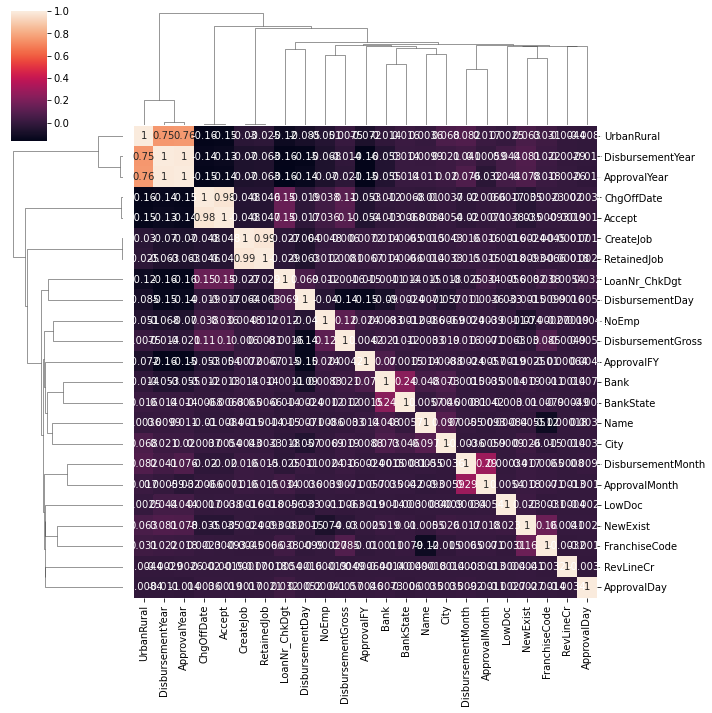

In [102]:
corrMatrix = df.corr()
sns.clustermap(corrMatrix, annot=True)
# plt.figure(figsize=(20000, 20000))
plt.show()

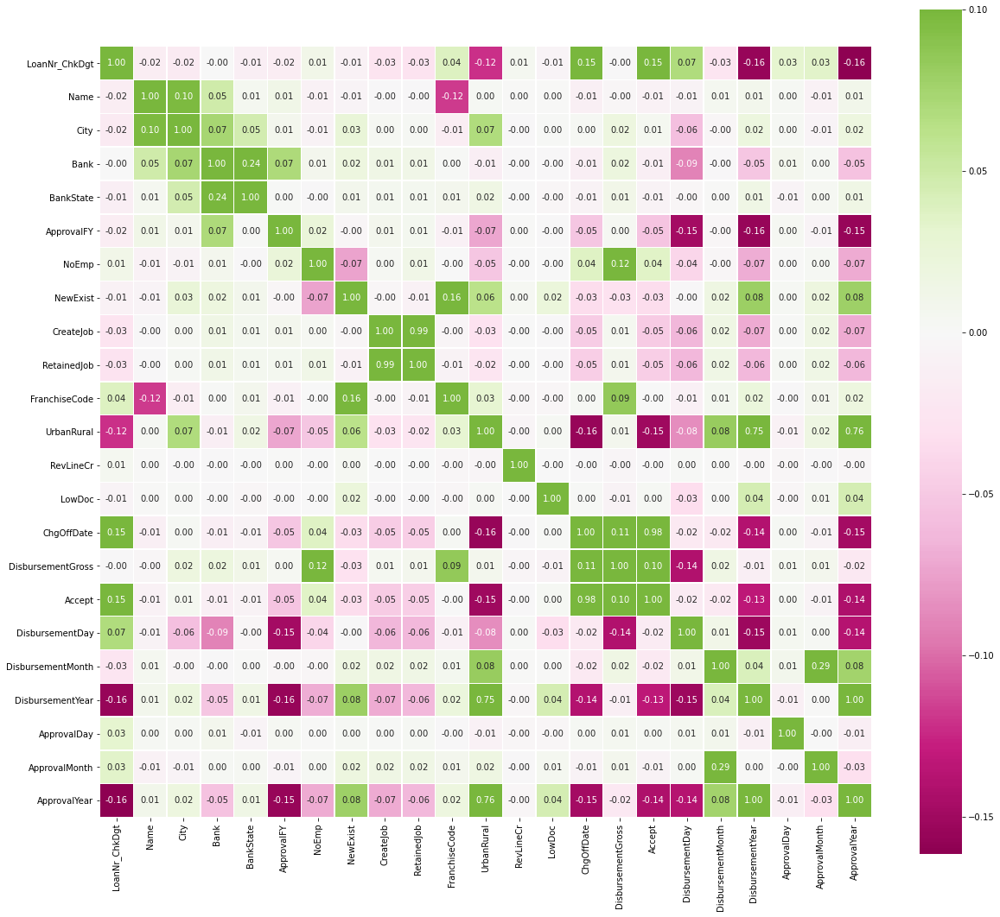

In [103]:
train = df

def corr_heatmap(train):
    correlations = train.corr()

    fig, ax = plt.subplots(figsize=(20,20))
    sns.heatmap(correlations, vmax=0.1, center=0, fmt='.2f',cmap="PiYG",
                square=True, linewidths=.5, annot=True, cbar_kws={"shrink": 0.9})
    plt.show();
    
corr_heatmap(train)

# 3. Machine learning model

Desarrolle uno o más modelos de aprendizaje automático para clasificar si una PYME debe (o no) recibir un crédito. Debe probar al menos: un algoritmo geométrico, un árbol de decisión y el algoritmo secreto recibido por el grupo. Discuta los resultados y valídelos.

## 3.1. Geometric model

### A. Todas las features 
### B. Reducción de features

## 3.2. Decision true
### A. Todas las features 
### B. Reducción de features

## 3.3. Gaussian NB
-----------------

## 3.1. Geometric model

### A. Todas las features 
### B. Reducción de features
-----------------

### A. Todas las features 

In [104]:
#Train Test Split
#Use train_test_split to split your data into a training set and a testing set
from sklearn.model_selection import train_test_split
features= ['LoanNr_ChkDgt', 'City', 'Bank', 'NoEmp', 'BankState', 'ApprovalFY', 'NoEmp', 'NewExist', 'CreateJob',
            'RetainedJob', 'FranchiseCode', 'UrbanRural', 'RevLineCr', 'LowDoc', 'DisbursementGross', 'DisbursementDay',
           'DisbursementMonth', 'ApprovalDay', 'ApprovalMonth', 'ApprovalYear']
X=df[features]
y=df['Accept']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

In [105]:
#Using KNN
#Import KNeighborsClassifier from scikit learn.
from sklearn.neighbors import KNeighborsClassifier

In [106]:
#Create a KNN model instance with n_neighbors=1
knn = KNeighborsClassifier(n_neighbors = 1)

In [107]:
#Fit this KNN model to the training data.
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=1)

In [108]:
#Predictions and Evaluations
#Let's evaluate our KNN model!
#Use the predict method to predict values using your KNN model and X_test.

pred = knn.predict(X_test)

In [109]:
#Create a confusion matrix and classification report.
from sklearn.metrics import classification_report, confusion_matrix

In [110]:
#Calculate the confusion matrix, which will help us to know the data that has been correctly predicted (main diagonal = 6730), and the wrong data (secondary diagonal = 1916)
print(confusion_matrix(y_test, pred))

[[ 776 2041]
 [2051 9697]]


In [111]:
#Calculate model precision
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       0.27      0.28      0.27      2817
           1       0.83      0.83      0.83     11748

    accuracy                           0.72     14565
   macro avg       0.55      0.55      0.55     14565
weighted avg       0.72      0.72      0.72     14565



In [112]:
#entrenamiento con 50 valores 
import numpy as np
error_rate = []
for i in range(1,10):
    knn = KNeighborsClassifier(n_neighbors = i)
    knn.fit(X_train, y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

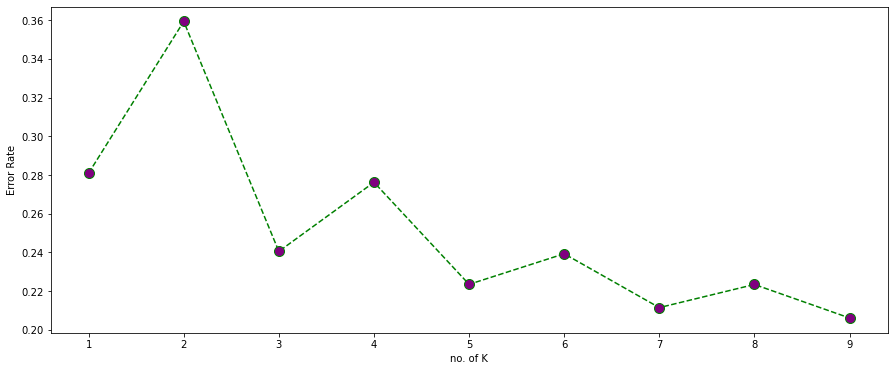

In [113]:
import matplotlib.pyplot as plt
plt.figure(figsize=(15,6))
plt.plot(range(1,10),error_rate,color='green',linestyle='dashed',marker='o', markerfacecolor='purple', markersize='10')
plt.xlabel('no. of K')
plt.ylabel('Error Rate')

In [114]:
#We use this code to find a best K number to our algorithm
from sklearn.model_selection import GridSearchCV
param_grid = {'n_neighbors': np.arange(1, 10,1)} 
gs = GridSearchCV(KNeighborsClassifier(), param_grid)
gs.fit(X_train, y_train)
print("Best score: ", gs.best_score_)
print("Best params: ", gs.best_params_)
for i, max_depth in enumerate(gs.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (gs.cv_results_['mean_test_score'][i],
                                        gs.cv_results_['std_test_score'][i] * 2,
                                        max_depth))

Best score:  0.7972748684351014
Best params:  {'n_neighbors': 9}
0.716 (+/-0.008) for {'n_neighbors': 1}
0.631 (+/-0.008) for {'n_neighbors': 2}
0.760 (+/-0.007) for {'n_neighbors': 3}
0.725 (+/-0.010) for {'n_neighbors': 4}
0.781 (+/-0.008) for {'n_neighbors': 5}
0.761 (+/-0.011) for {'n_neighbors': 6}
0.790 (+/-0.006) for {'n_neighbors': 7}
0.780 (+/-0.008) for {'n_neighbors': 8}
0.797 (+/-0.006) for {'n_neighbors': 9}


In [115]:
#kNN para 9 vecinos
knn = KNeighborsClassifier(n_neighbors =9)
knn.fit(X_train, y_train)
pred = knn.predict(X_test)
print(confusion_matrix(y_test, pred))
print(classification_report(y_test, pred))

[[  238  2579]
 [  423 11325]]
              precision    recall  f1-score   support

           0       0.36      0.08      0.14      2817
           1       0.81      0.96      0.88     11748

    accuracy                           0.79     14565
   macro avg       0.59      0.52      0.51     14565
weighted avg       0.73      0.79      0.74     14565



### B. Reducción de features

In [116]:
#Train Test Split
#Use train_test_split to split your data into a training set and a testing set
from sklearn.model_selection import train_test_split
features = ['ChgOffDate']
X=df[features]
y=df['Accept']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

In [117]:
#Using KNN
#Import KNeighborsClassifier from scikit learn.
from sklearn.neighbors import KNeighborsClassifier

In [118]:
#Create a KNN model instance with n_neighbors=1
knn = KNeighborsClassifier(n_neighbors = 1)

In [114]:
#Fit this KNN model to the training data.
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=1)

In [115]:
#Predictions and Evaluations
#Let's evaluate our KNN model!
#Use the predict method to predict values using your KNN model and X_test.

pred = knn.predict(X_test)

In [116]:
#Create a confusion matrix and classification report.
from sklearn.metrics import classification_report, confusion_matrix

In [117]:
#Calculate the confusion matrix, which will help us to know the data that has been correctly predicted (main diagonal = 6730), and the wrong data (secondary diagonal = 1916)
print(confusion_matrix(y_test, pred))

[[ 782 2035]
 [2048 9700]]


In [118]:
#Calculate model precision
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       0.28      0.28      0.28      2817
           1       0.83      0.83      0.83     11748

    accuracy                           0.72     14565
   macro avg       0.55      0.55      0.55     14565
weighted avg       0.72      0.72      0.72     14565



In [119]:
#entrenamiento con 50 valores 
import numpy as np
error_rate = []
for i in range(1,50):
    knn = KNeighborsClassifier(n_neighbors = i)
    knn.fit(X_train, y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

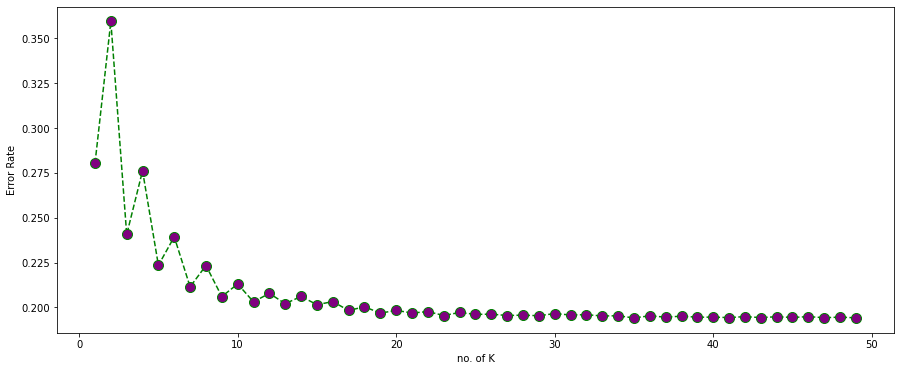

In [120]:
import matplotlib.pyplot as plt
plt.figure(figsize=(15,6))
plt.plot(range(1,10),error_rate,color='green',linestyle='dashed',marker='o', markerfacecolor='purple', markersize='10')
plt.xlabel('no. of K')
plt.ylabel('Error Rate')

In [121]:
#We use this code to find a best K number to our algorithm
from sklearn.model_selection import GridSearchCV
param_grid = {'n_neighbors': np.arange(1, 10,1)} 
gs = GridSearchCV(KNeighborsClassifier(), param_grid)
gs.fit(X_train, y_train)
print("Best score: ", gs.best_score_)
print("Best params: ", gs.best_params_)
for i, max_depth in enumerate(gs.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (gs.cv_results_['mean_test_score'][i],
                                        gs.cv_results_['std_test_score'][i] * 2,
                                        max_depth))

Best score:  0.7972748684351014
Best params:  {'n_neighbors': 9}
0.716 (+/-0.007) for {'n_neighbors': 1}
0.631 (+/-0.008) for {'n_neighbors': 2}
0.760 (+/-0.007) for {'n_neighbors': 3}
0.725 (+/-0.010) for {'n_neighbors': 4}
0.781 (+/-0.008) for {'n_neighbors': 5}
0.761 (+/-0.010) for {'n_neighbors': 6}
0.790 (+/-0.006) for {'n_neighbors': 7}
0.780 (+/-0.008) for {'n_neighbors': 8}
0.797 (+/-0.006) for {'n_neighbors': 9}


In [122]:
#kNN para 9 vecinos
knn = KNeighborsClassifier(n_neighbors =9)
knn.fit(X_train, y_train)
pred = knn.predict(X_test)
print(confusion_matrix(y_test, pred))
print(classification_report(y_test, pred))

[[  238  2579]
 [  422 11326]]
              precision    recall  f1-score   support

           0       0.36      0.08      0.14      2817
           1       0.81      0.96      0.88     11748

    accuracy                           0.79     14565
   macro avg       0.59      0.52      0.51     14565
weighted avg       0.73      0.79      0.74     14565



In [123]:
ids_test = df_test_nolabel['id']

features = ['LoanNr_ChkDgt', 'UrbanRural', 'DisbursementGross', 'ApprovalYear']
X=df_test_nolabel[features]
y_pred=knn.predict(X)

In [124]:
results = df_test_nolabel[["id"]]
results["AcceptFloat"] = y
results["Accept"] = results["AcceptFloat"].values.astype(int)
results.drop(['AcceptFloat'], axis=1, inplace=True)
results["id"].size

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\ablaz\anaconda3\lib\site-packages\pandas\core\frame.py:4315: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: htt

7994

In [125]:
results.to_csv("resultsKNN2.csv", index_label=False, index=False)

## 3.2. Decision tree

### A. Todas las features 
### B. Reducción de features
-----------------

### A. Todas las features 

In [119]:
# Training and test spliting
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

# Features of the model
#features = ['LoanNr_ChkDgt', 'City', 'Bank', 'NoEmp', 'BankState', 'ApprovalFY', 'NoEmp', 'NewExist', 'CreateJob',
#            'RetainedJob', 'FranchiseCode', 'UrbanRural', 'RevLineCr', 'LowDoc', 'DisbursementGross', 'DisbursementDay',
#           'DisbursementMonth', 'ApprovalDay', 'ApprovalMonth', 'ApprovalYear']

# Si se incluyen features con nan no funciona el árbol
features = ['LoanNr_ChkDgt', 'City', 'Bank', 'NoEmp', 'ApprovalFY', 'NoEmp', 'NewExist', 'CreateJob',
            'RetainedJob', 'FranchiseCode', 'UrbanRural', 'DisbursementGross',
           'ApprovalDay', 'ApprovalMonth', 'ApprovalYear']

# Transform dataframe in numpy arrays
X = df[features].values
y = df['Accept'].values

# Test set will be the 25% taken randomly
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=33)

# Preprocess: normalize
scaler = preprocessing.StandardScaler().fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [148]:
from sklearn.model_selection import GridSearchCV
param_grid = {'max_depth': np.arange(1, 20)} 

gs = GridSearchCV(DecisionTreeClassifier(), param_grid)

gs.fit(X_train, y_train)

# summarize the results of the grid search
print("Best score: ", gs.best_score_)
print("Best params: ", gs.best_params_)

Best score:  0.8292776709695138
Best params:  {'max_depth': 6}


In [149]:
# We print the score for each value of max_depth
for i, max_depth in enumerate(gs.cv_results_['params']):
    print("%0.4f (+/-%0.04f) for %r" % (gs.cv_results_['mean_test_score'][i],
                                        gs.cv_results_['std_test_score'][i] * 2,
                                        max_depth))

0.8107 (+/-0.0001) for {'max_depth': 1}
0.8107 (+/-0.0001) for {'max_depth': 2}
0.8202 (+/-0.0028) for {'max_depth': 3}
0.8226 (+/-0.0047) for {'max_depth': 4}
0.8266 (+/-0.0052) for {'max_depth': 5}
0.8293 (+/-0.0039) for {'max_depth': 6}
0.8283 (+/-0.0048) for {'max_depth': 7}
0.8275 (+/-0.0063) for {'max_depth': 8}
0.8231 (+/-0.0023) for {'max_depth': 9}
0.8219 (+/-0.0048) for {'max_depth': 10}
0.8200 (+/-0.0042) for {'max_depth': 11}
0.8149 (+/-0.0036) for {'max_depth': 12}
0.8081 (+/-0.0047) for {'max_depth': 13}
0.8015 (+/-0.0047) for {'max_depth': 14}
0.7970 (+/-0.0056) for {'max_depth': 15}
0.7876 (+/-0.0068) for {'max_depth': 16}
0.7840 (+/-0.0084) for {'max_depth': 17}
0.7778 (+/-0.0105) for {'max_depth': 18}
0.7732 (+/-0.0042) for {'max_depth': 19}


In [150]:
# Evaluation
from sklearn import metrics
from sklearn.model_selection import cross_val_score, KFold, StratifiedKFold
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

model = tree.DecisionTreeClassifier(criterion='gini',
                                            splitter="best",
                                            min_samples_split=8,
                                            min_samples_leaf=4,
                                            max_depth = 7,
                                            class_weight= {0:0.96,1:0.96} )

model.fit(X_train, y_train)
predicted = model.predict(X_test)
expected = y_test

# Accuracy
metrics.accuracy_score(expected, predicted)

0.8264810084864465

In [151]:
cv = KFold(n_splits=20, shuffle=False)
scores = cross_val_score(model, X, y, cv=cv)

print("Scores in every iteration", scores)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Scores in every iteration [0.82331137 0.82413509 0.83196046 0.8315486  0.81425041 0.82990115
 0.82166392 0.82488669 0.83559951 0.83271529 0.82777091 0.83848372
 0.81911825 0.83395138 0.8170581  0.83971982 0.82735888 0.8368356
 0.83889576 0.82159044]
Accuracy: 0.83 (+/- 0.01)


In [152]:
y_train_pred = model.predict(X_train)
print("Accuracy in training", metrics.accuracy_score(y_train, y_train_pred))

Accuracy in training 0.8328206536665751


In [153]:
print(classification_report(y_train, y_train_pred))

              precision    recall  f1-score   support

           0       0.71      0.20      0.31      6892
           1       0.84      0.98      0.90     29518

    accuracy                           0.83     36410
   macro avg       0.77      0.59      0.61     36410
weighted avg       0.81      0.83      0.79     36410



Se halla cuál tiene nans, y se descartan como features DisbursementMonth and DisbursementDay

In [154]:
(df_test_nolabel.isna().sum()/df_test_nolabel.shape[0]).sort_values(ascending=True)

id                   0.000000
ApprovalDay          0.000000
DisbursementGross    0.000000
LowDoc               0.000000
RevLineCr            0.000000
UrbanRural           0.000000
FranchiseCode        0.000000
ApprovalMonth        0.000000
CreateJob            0.000000
RetainedJob          0.000000
NoEmp                0.000000
ApprovalFY           0.000000
BankState            0.000000
Bank                 0.000000
City                 0.000000
Name                 0.000000
LoanNr_ChkDgt        0.000000
NewExist             0.000000
ApprovalYear         0.000000
DisbursementDay      0.001751
DisbursementMonth    0.001751
DisbursementYear     0.001751
dtype: float64

In [155]:
ids_test = df_test_nolabel['id']

features = ['LoanNr_ChkDgt', 'City', 'Bank', 'NoEmp', 'ApprovalFY', 'NoEmp', 'NewExist', 'CreateJob',
            'RetainedJob', 'FranchiseCode', 'UrbanRural', 'DisbursementGross',
           'ApprovalDay', 'ApprovalMonth', 'ApprovalYear']
X=df_test_nolabel[features]
y_pred=model.predict(X)

In [156]:
results = df_test_nolabel[["id"]]
results["AcceptFloat"] = y_pred
results["Accept"] = results["AcceptFloat"].values.astype(int)
results.drop(['AcceptFloat'], axis=1, inplace=True)
results["id"].size

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\ablaz\anaconda3\lib\site-packages\pandas\core\frame.py:4315: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: htt

7994

In [157]:
results.to_csv("resultsDT1.csv", index_label=False, index=False)

## B. Reducción de features

Hacemos otra gráfica en la que podamos ver con colores los parámetros más correlados con Accept.
Por tanto seleccionamos los campos: 'LoanNr_ChdkDgt', 'UrbanRural', 'DisburstmentGross', 'ApprovalYear'

In [283]:
# Training and test spliting
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

# Features of the model
features = ['LoanNr_ChkDgt', 'UrbanRural', 'DisbursementGross', 'ApprovalYear']
# Transform dataframe in numpy arrays
X = df[features].values
y = df['Accept'].values

# Test set will be the 25% taken randomly
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=33)

# Preprocess: normalize
scaler = preprocessing.StandardScaler().fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [284]:
from sklearn.model_selection import GridSearchCV
param_grid = {'max_depth': np.arange(1, 20)} 

gs = GridSearchCV(DecisionTreeClassifier(), param_grid)

gs.fit(X_train, y_train)

# summarize the results of the grid search
print("Best score: ", gs.best_score_)
print("Best params: ", gs.best_params_)

Best score:  0.8216441733848834
Best params:  {'max_depth': 4}


In [285]:
# We print the score for each value of max_depth
for i, max_depth in enumerate(gs.cv_results_['params']):
    print("%0.4f (+/-%0.04f) for %r" % (gs.cv_results_['mean_test_score'][i],
                                        gs.cv_results_['std_test_score'][i] * 2,
                                        max_depth))

0.8124 (+/-0.0001) for {'max_depth': 1}
0.8197 (+/-0.0026) for {'max_depth': 2}
0.8208 (+/-0.0021) for {'max_depth': 3}
0.8216 (+/-0.0026) for {'max_depth': 4}
0.8205 (+/-0.0046) for {'max_depth': 5}
0.8206 (+/-0.0036) for {'max_depth': 6}
0.8199 (+/-0.0066) for {'max_depth': 7}
0.8186 (+/-0.0083) for {'max_depth': 8}
0.8180 (+/-0.0056) for {'max_depth': 9}
0.8162 (+/-0.0067) for {'max_depth': 10}
0.8146 (+/-0.0055) for {'max_depth': 11}
0.8117 (+/-0.0074) for {'max_depth': 12}
0.8090 (+/-0.0073) for {'max_depth': 13}
0.8065 (+/-0.0057) for {'max_depth': 14}
0.8036 (+/-0.0077) for {'max_depth': 15}
0.7992 (+/-0.0127) for {'max_depth': 16}
0.7955 (+/-0.0077) for {'max_depth': 17}
0.7926 (+/-0.0106) for {'max_depth': 18}
0.7895 (+/-0.0073) for {'max_depth': 19}


In [286]:
# Evaluation
from sklearn import metrics
from sklearn.model_selection import cross_val_score, KFold, StratifiedKFold
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

model = tree.DecisionTreeClassifier(criterion='gini',
                                            splitter="best",
                                            min_samples_split=8,
                                            min_samples_leaf=4,
                                            max_depth = 4,
                                            class_weight= {0:0.96,1:0.96} )

model.fit(X_train, y_train)
predicted = model.predict(X_test)
expected = y_test

# Accuracy
metrics.accuracy_score(expected, predicted)

0.8155251893315772

In [159]:
print(classification_report(y_train, y_train_pred))

              precision    recall  f1-score   support

           0       0.71      0.20      0.31      6892
           1       0.84      0.98      0.90     29518

    accuracy                           0.83     36410
   macro avg       0.77      0.59      0.61     36410
weighted avg       0.81      0.83      0.79     36410



## 3.3. GaussianNB

A continuación entrenamos el algoritmo Gaussian Naive Bayes

In [171]:
#Train Test Split
#Use train_test_split to split your data into a training set and a testing set
from sklearn.model_selection import train_test_split
features= ['LoanNr_ChkDgt', 'City', 'Bank', 'NoEmp', 'BankState', 'ApprovalFY', 'NoEmp', 'NewExist', 'CreateJob',
            'RetainedJob', 'FranchiseCode', 'UrbanRural', 'RevLineCr', 'LowDoc', 'DisbursementGross', 'DisbursementDay',
           'ApprovalMonth', 'ApprovalYear']
X=df[features]
y=df['Accept']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

In [172]:
#Import Gaussian Naive Bayes model
from sklearn.naive_bayes import GaussianNB

#Create a Gaussian Classifier
model = GaussianNB()

# Train the model using the training sets
model.fit(X_train, y_train)

#Predict Output
predicted= model.predict(X_test) # 0:Overcast, 2:Mild
print ("Predicted Value:", predicted)

Predicted Value: [1 1 1 ... 1 1 1]


In [173]:
#Create a confusion matrix and classification report.
from sklearn.metrics import classification_report, confusion_matrix
#Calculate the confusion matrix, which will help us to know the data that has been correctly predicted (main diagonal = 6730), and the wrong data (secondary diagonal = 1916)
print(confusion_matrix(y_test, pred))

[[  238  2579]
 [  422 11326]]


In [174]:
#Calculate model precision
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       0.36      0.08      0.14      2817
           1       0.81      0.96      0.88     11748

    accuracy                           0.79     14565
   macro avg       0.59      0.52      0.51     14565
weighted avg       0.73      0.79      0.74     14565



In [175]:
(df_test_nolabel.isna().sum()/df_test_nolabel.shape[0]).sort_values(ascending=True)

id                   0.000000
ApprovalDay          0.000000
DisbursementGross    0.000000
LowDoc               0.000000
RevLineCr            0.000000
UrbanRural           0.000000
FranchiseCode        0.000000
ApprovalMonth        0.000000
CreateJob            0.000000
RetainedJob          0.000000
NoEmp                0.000000
ApprovalFY           0.000000
BankState            0.000000
Bank                 0.000000
City                 0.000000
Name                 0.000000
LoanNr_ChkDgt        0.000000
NewExist             0.000000
ApprovalYear         0.000000
DisbursementDay      0.001751
DisbursementMonth    0.001751
DisbursementYear     0.001751
dtype: float64

In [176]:
ids_test = df_test_nolabel['id']

features = ['LoanNr_ChkDgt', 'City', 'Bank', 'NoEmp', 'BankState', 'ApprovalFY', 'NoEmp', 'NewExist', 'CreateJob',
            'RetainedJob', 'FranchiseCode', 'UrbanRural', 'RevLineCr', 'LowDoc', 'DisbursementGross', 'ApprovalDay', 'ApprovalMonth', 'ApprovalYear']
X=df_test_nolabel[features]
y_pred=model.predict(X)

In [177]:
results = df_test_nolabel[["id"]]
results["AcceptFloat"] = y_pred
results["Accept"] = results["AcceptFloat"].values.astype(int)
results.drop(['AcceptFloat'], axis=1, inplace=True)
results["id"].size

C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ablaz\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\ablaz\anaconda3\lib\site-packages\pandas\core\frame.py:4315: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: htt

7994

In [178]:
results.to_csv("resultsGaussianNB.csv", index_label=False, index=False)

In [ ]:
from sklearn.model_selection import cross_val_score, KFold
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# create a composite estimator made by a pipeline of preprocessing and the KNN model
model = Pipeline([
        ('scaler', StandardScaler()),
        ('DecisionTree', DecisionTreeClassifier())
])

# create a k-fold cross validation iterator of k=10 folds
cv = KFold(10, shuffle=True, random_state=33)

# by default the score used is the one returned by score method of the estimator (accuracy)
scores = cross_val_score(model, x_iris, y_iris, cv=cv)
print(scores)

### 3.4 Mejora de modelos

Nos percatamos de que el campo ChgOffDate, que a priori hemos descartado por tener muchos Nans, como da la fecha en la que el deudor asume que no puede pagar su deuda. De forma que si es nan, hay muchas más posibilidades que se le conceda el crédito que si es cero.

#### 1- KNN
#### 2- Decision Tree
#### 3- Gaussian NB
------------------

#### 1- KNN

Para realziar la predición se rellena con 0s los valores nan:

In [104]:
#df_6 = data.copy()
df['ChgOffDate'] = df['ChgOffDate'].fillna(1)

for i in range(len(df)):
    if df['ChgOffDate'][i] != 1 :
        df['ChgOffDate'][i] = 0                         

<ipython-input-104-0e080e145526>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['ChgOffDate'][i] = 0


In [105]:
df['ChgOffDate'] = df['ChgOffDate'].astype(int)

In [106]:
df.dtypes

LoanNr_ChkDgt          int64
Name                  object
City                  object
Bank                  object
BankState             object
ApprovalDate          object
ApprovalFY            object
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr             object
LowDoc                object
ChgOffDate             int32
DisbursementDate      object
DisbursementGross     object
Accept                 int64
dtype: object

In [157]:
#df_6 = data.copy()
df_test_nolabel['ChgOffDate'] = df_test_nolabel['ChgOffDate'].fillna(1)

for i in range(len(df_test_nolabel)):
    if df_test_nolabel['ChgOffDate'][i] != 1 :
        df_test_nolabel['ChgOffDate'][i] = 0   

<ipython-input-157-982c08d9f062>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test_nolabel['ChgOffDate'][i] = 0


In [158]:
df_test_nolabel['ChgOffDate'] = df_test_nolabel['ChgOffDate'].astype(int)

In [240]:
df.head()


,LoanNr_ChkDgt,Name,City,Bank,BankState,ApprovalFY,NoEmp,NewExist,CreateJob,RetainedJob,...,LowDoc,ChgOffDate,DisbursementGross,Accept,DisbursementDay,DisbursementMonth,DisbursementYear,ApprovalDay,ApprovalMonth,ApprovalYear
7,3075105006,7.0,7.0,7.0,7.0,7.0,1,1.0,1,1,...,0.0,13-Jun-13,122026.0,0,31.0,5.0,2008.0,2,5,2008
8,7362314004,8.0,8.0,8.0,2.0,5.0,3,2.0,0,0,...,2.0,28-Aug-07,85000.0,0,30.0,4.0,2004.0,16,4,2004
9,3204516004,9.0,9.0,3.0,3.0,7.0,1,1.0,0,1,...,0.0,20-Nov-13,13844.0,0,1.0,6.0,2010.0,25,3,2008
14,6414154002,14.0,14.0,14.0,2.0,0.0,10,1.0,0,0,...,0.0,22-Apr-11,156000.0,0,30.0,6.0,2003.0,17,6,2003
18,3437144009,18.0,18.0,3.0,2.0,15.0,2,1.0,2,2,...,0.0,18-Apr-06,180000.0,0,29.0,2.0,2000.0,3,12,1999


In [159]:
#Train Test Split
#Use train_test_split to split your data into a training set and a testing set
from sklearn.model_selection import train_test_split
features= ['LoanNr_ChkDgt', 'City', 'Bank', 'NoEmp', 'BankState', 'ApprovalFY', 'NoEmp', 'NewExist', 'CreateJob',
            'RetainedJob', 'FranchiseCode', 'UrbanRural', 'RevLineCr', 'LowDoc', 'ChgOffDate', 'DisbursementGross', 'DisbursementDay',
           'DisbursementMonth', 'ApprovalDay', 'ApprovalMonth', 'ApprovalYear']
X=df[features]
y=df['Accept']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

In [160]:
#Using KNN
#Import KNeighborsClassifier from scikit learn.
from sklearn.neighbors import KNeighborsClassifier

In [161]:
#Create a KNN model instance with n_neighbors=1
knn = KNeighborsClassifier(n_neighbors = 1)

In [162]:
#Fit this KNN model to the training data.
knn.fit(X_train, y_train)

ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [ ]:
#Predictions and Evaluations
#Let's evaluate our KNN model!
#Use the predict method to predict values using your KNN model and X_test.

pred = knn.predict(X_test)

In [ ]:
#Create a confusion matrix and classification report.
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
#Calculate the confusion matrix, which will help us to know the data that has been correctly predicted (main diagonal = 6730), and the wrong data (secondary diagonal = 1916)
print(confusion_matrix(y_test, pred))

In [ ]:
#Calculate model precision
print(classification_report(y_test, pred))

In [ ]:
#entrenamiento con 50 valores 
import numpy as np
error_rate = []
for i in range(1,10):
    knn = KNeighborsClassifier(n_neighbors = i)
    knn.fit(X_train, y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(15,6))
plt.plot(range(1,10),error_rate,color='green',linestyle='dashed',marker='o', markerfacecolor='purple', markersize='10')
plt.xlabel('no. of K')
plt.ylabel('Error Rate')

In [ ]:
#We use this code to find a best K number to our algorithm
from sklearn.model_selection import GridSearchCV
param_grid = {'n_neighbors': np.arange(1, 10,1)} 
gs = GridSearchCV(KNeighborsClassifier(), param_grid)
gs.fit(X_train, y_train)
print("Best score: ", gs.best_score_)
print("Best params: ", gs.best_params_)
for i, max_depth in enumerate(gs.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r" % (gs.cv_results_['mean_test_score'][i],
                                        gs.cv_results_['std_test_score'][i] * 2,
                                        max_depth))

In [ ]:
#kNN para 9 vecinos
knn = KNeighborsClassifier(n_neighbors =9)
knn.fit(X_train, y_train)
pred = knn.predict(X_test)
print(confusion_matrix(y_test, pred))
print(classification_report(y_test, pred))

NameError: name 'df' is not defined

# 4. Result of the competition

### A. Introducción
### B. Modelo Geométrico: KNN
### C. Modelo Decision Tree
### D. Modelo Gaussian NB
-----------------------------------------

### A. Introducción

Una vez disponga de un modelo, deberá usar la plataforma Kaggle para probar su modelo con datos, que combinan datos nuevos con los datos existentes. Puede realizar tantos intentos como desee. 
Razone los resultados en el cuaderno.

### B. Modelo Geométrico: KNN

 Knn para 9 vecinos con todas las features preprocesadas
 
      precision    recall  f1-score   support

           0       0.28      0.28      0.28      2817
           1       0.83      0.83      0.83     11748

    accuracy                           0.72     14565
   macro avg       0.55      0.55      0.55     14565
weighted avg       0.72      0.72      0.72     14565

Best score:  0.7972748684351014
Best params:  {'n_neighbors': 9}

  Knn para 9 vecinos con 4 features preprocesadas
  
       precision    recall  f1-score   support

           0       0.36      0.08      0.14      2817
           1       0.81      0.96      0.88     11748

    accuracy                           0.79     14565
   macro avg       0.59      0.52      0.51     14565
weighted avg       0.73      0.79      0.74     14565

Best score:  0.7972748684351014
Best params:  {'n_neighbors': 9}


Knn con 4 features: 0.62095

### C. Modelo Decision Tree

Decison tree con todas las variables (bueno, las que no tienen nan) preprocesadas 

              precision    recall  f1-score   support

           0       0.71      0.22      0.34      6892
           1       0.84      0.98      0.91     29518

    accuracy                           0.84     36410
   macro avg       0.78      0.60      0.62     36410
weighted avg       0.82      0.84      0.80     36410

Accuracy in training 0.8353474320241692

Best score:  0.8292776709695138
Best params:  {'max_depth': 6}

0.66588 en kaagle 

Decison tree con 4 variables preprocesadas

              precision    recall  f1-score   support

           0       0.71      0.20      0.31      6892
           1       0.84      0.98      0.90     29518

    accuracy                           0.83     36410
   macro avg       0.77      0.59      0.61     36410
weighted avg       0.81      0.83      0.79     36410

0.8155251893315772


Tienen mejor valor en el 0 que el knn

Con 4 vecinos

                 precision    recall  f1-score   support

           0       0.98      1.00      0.99      1902
           1       1.00      1.00      1.00      7808

    accuracy                           1.00      9710
   macro avg       0.99      1.00      0.99      9710
weighted avg       1.00      1.00      1.00      9710

Con 9 vecinos

              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1902
           1       1.00      1.00      1.00      7808

    accuracy                           1.00      9710
   macro avg       0.99      1.00      0.99      9710
weighted avg       1.00      1.00      1.00      9710


### D. Modelo Gaussian NB

              precision    recall  f1-score   support

           0       0.36      0.08      0.14      2817
           1       0.81      0.96      0.88     11748

    accuracy                           0.79     14565
   macro avg       0.59      0.52      0.51     14565
weighted avg       0.73      0.79      0.74     14565

# 5. Presentation discussion

# References

Notebooks de la asignatura